In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely
import numpy as np
import pandas as pd
import mapclassify as mc
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors
import matplotlib.lines as mlines
import os
import rasterio
from rasterio.features import rasterize
from rasterio.transform import from_bounds
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from rasterio.plot import show
from rasterio.features import shapes
from rasterio.enums import Resampling
from affine import Affine

# Definición de la región de referencia para un proyecto REDD+

Dado que el objetivo del proyecto es encontrar una zona similar al área del proyecto (Resguardo Indígena Alto Unuma), para establecer una línea base de un proyecto REDD+, se delimita un ROI (Region Of Interest) sobre el cual se realizan todas las clasificaciones que permitan determinar su similitud con el área del proyecto.

## Descripción poblacional de la región

A continuación, se describen los datos poblacionales de la región de interés:

In [13]:
#Insumos 
# ---- Cargar los datos ----
Poblacion = "../Data/Poblacion.csv"  # Ruta del CSV
MunicipiosROI = "../Data/Municipios_ROI.shp"  # Ruta del Shapefile

C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


📌 Límites de Natural Breaks: [  5007.  13291.  33440.  48086. 156942.]


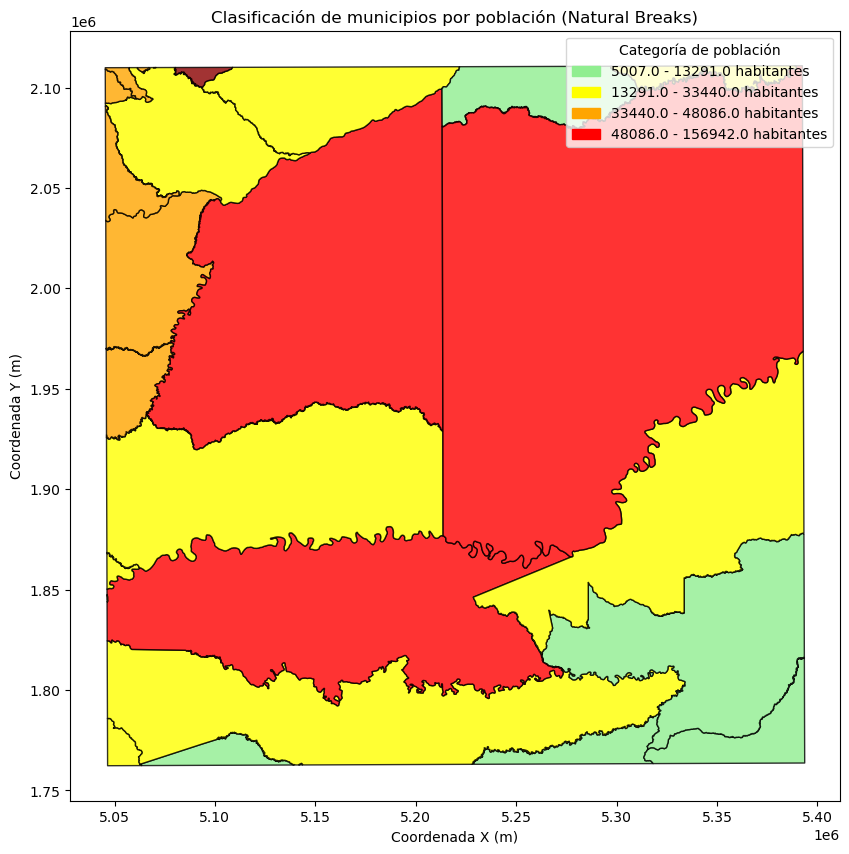

In [3]:
# Cargar CSV con población
df_poblacion = pd.read_csv(Poblacion)

# Cargar archivo geográfico de municipios
gdf_municipios = gpd.read_file(MunicipiosROI)

# 🔹 **Unir la información de población con los municipios** (clave: nombre del municipio)
gdf = gdf_municipios.merge(df_poblacion, on="MpNombre", how="left")

# ---- Aplicar Natural Breaks ----
# Se segmenta la población en 5 grupos automáticamente
nb = mc.NaturalBreaks(gdf["Poblacion"], k=5)
gdf["categoria_poblacion"] = nb.yb  # Asignar la categoría correspondiente

# Extraer los límites de los Natural Breaks
breaks = nb.bins
print("📌 Límites de Natural Breaks:", breaks)

# ---- Visualización del mapa ----
fig, ax = plt.subplots(figsize=(10, 10))

# Asignar colores según la clasificación
color_map = {0: "lightgreen", 1: "yellow", 2: "orange", 3: "red", 4: "darkred"}
gdf["color"] = gdf["categoria_poblacion"].map(color_map)

# Ploteo de los municipios con clasificación
gdf.plot(ax=ax, color=gdf["color"], edgecolor="black", alpha=0.8)

# Crear leyenda con los intervalos de Natural Breaks
labels = [f"{round(breaks[i], 0)} - {round(breaks[i+1], 0)} habitantes" for i in range(len(breaks)-1)]
legend_patches = [mpatches.Patch(color=color_map[i], label=labels[i]) for i in range(len(labels))]

ax.legend(handles=legend_patches, title="Categoría de población", loc='upper right')

# Configuración del gráfico
ax.set_title("Clasificación de municipios por población (Natural Breaks)")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")

plt.show()

## Parámetros globales

Se definen las siguientes variables globales que se aplicarán a lo largo del código. Esto con el principal objetivo de definir la resolución de trabajo en los geoprocesamientos, en este caso, 10 km (10.000 metros). 

In [20]:
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
res = 20000

Así mismo, para la clasificación de todas las variables se va a usar la misma leyenda de colores:

In [5]:
color_map = {
    4: "darkgreen",  # Mayor similitud
    3: "green",
    2: "yellow",
    1: "orange",
    0: "red"  # Menor simulitud
}

## Insumos globales

Se relacionan algunas variables globales tales como el área del proyecto y el ROI.

In [12]:
ProjectArea = gpd.read_file("../Data/RI_UNUMA_Project.shp")
ROI = gpd.read_file("../Data/ROI_3.shp")

# Variables

## Procesamientos vector

### 1. Uso de la tierra

#### 1.1 Coberturas de la tierra

Se utiliza como insumo: Cobertura de la tierra 100K Periodo 2020 limite administrativo. Disponible en: https://e436.short.gy/CobTie2020 

In [7]:
#Insumos 
LandUseProject = "Data\\Coberturas_project_area.shp"
LandUseROI = "Data\\Coberturas_ROI.shp"

##### 1.1.1 Coberturas de la tierra en el área del proyecto

A continuación, se presentan las coberturas dentro del área del proyecto. Es decir, el resguardo indígena Alto Unuma. Se define el nivel 1 de coberturas de la metodología adaptada de Corine Land Cover para facilidades en el procesamiento.

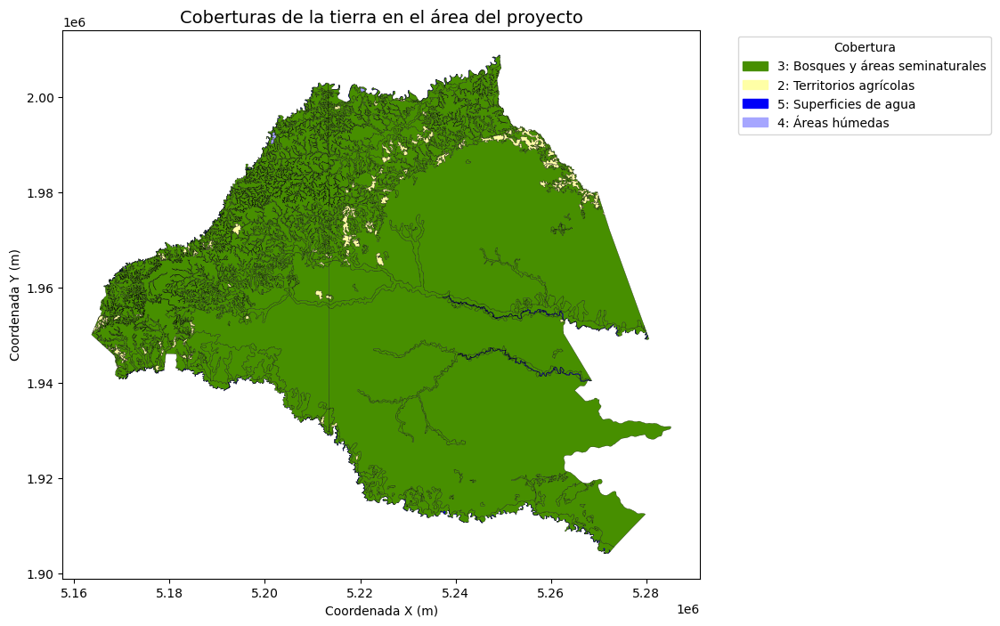

In [8]:
def visualize_land_cover(LandUseProject, column_name='nivel_1'):
    # Cargar la capa geoespacial
    gdf = gpd.read_file(LandUseProject)

    # Convertir valores de la columna 'nivel_1' a enteros
    gdf[column_name] = gdf[column_name].astype(str).str.strip()
    try:
        gdf[column_name] = gdf[column_name].astype(int)
    except ValueError:
        raise ValueError(f"⚠️ No se pueden convertir los valores de '{column_name}' a enteros. Valores encontrados: {gdf[column_name].unique()}")

    # Diccionario de etiquetas y colores
    cover_labels = {
        3: "Bosques y áreas seminaturales",
        2: "Territorios agrícolas",
        5: "Superficies de agua",
        4: "Áreas húmedas"
    }

    color_map = {
        3: "#478F00",  # Bosques
        2: "#FFFFA6",  # Territorios agrícolas
        5: "#0000F8",  # Superficies de agua
        4: "#A6A6FF"   # Áreas húmedas
    }

    # Crear la visualización
    fig, ax = plt.subplots(figsize=(10, 8))
    legend_patches = []

    for cover, color in color_map.items():
        subset = gdf[gdf[column_name] == cover]
        if subset.empty:
            print(f"⚠️ No hay datos para la categoría {cover} ({cover_labels.get(cover, 'Desconocido')})")
            continue  # Evita errores si una categoría no está presente

        subset.plot(ax=ax, color=color, edgecolor='black', linewidth=0.2)
        legend_patches.append(mpatches.Patch(color=color, label=f"{cover}: {cover_labels.get(cover, 'Desconocido')}"))

    # Configuración del mapa
    ax.set_title("Coberturas de la tierra en el área del proyecto", fontsize=14)
    ax.set_xlabel("Coordenada X (m)")
    ax.set_ylabel("Coordenada Y (m)")
    ax.legend(handles=legend_patches, title="Cobertura", bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.show()

# Uso del script
visualize_land_cover(LandUseProject)

###### 1.1.1.1 Proporción de áreas para cada categoría de coberturas de la tierra

Una vez definidas las coberturas presentes en el área del proyecto se calcula su proporción, para asi definir las categorías a aplicar en el ROI.

In [9]:
def calculate_land_cover_areas(LandUseProject, column_name='nivel_1'):
    # Cargar la capa geoespacial
    gdf = gpd.read_file(LandUseProject)

    if gdf.crs.to_epsg() != 9377:
        gdf = gdf.to_crs(epsg=9377)

    # Verificar que la columna de clasificación exista
    if column_name not in gdf.columns:
        raise ValueError(f"⚠️ La columna '{column_name}' no existe en el archivo.")

    # Convertir valores a enteros si es necesario
    gdf[column_name] = gdf[column_name].astype(str).str.strip()
    try:
        gdf[column_name] = gdf[column_name].astype(int)
    except ValueError:
        raise ValueError(f"⚠️ No se pueden convertir los valores de '{column_name}' a enteros. Valores encontrados: {gdf[column_name].unique()}")

    # Calcular el área de cada polígono
    gdf['area_ha'] = gdf.geometry.area/10000

    # Agrupar por categoría y sumar el área
    area_by_category = gdf.groupby(column_name)['area_ha'].sum().reset_index()

    # Calcular el área total
    total_area = area_by_category['area_ha'].sum()

    # Calcular la proporción de cada categoría respecto al total
    area_by_category['proporcion'] = (area_by_category['area_ha'] / total_area) * 100

     # Redondear área y proporción a 2 decimales
    area_by_category['area_ha'] = area_by_category['area_ha'].round(2)
    area_by_category['proporcion'] = area_by_category['proporcion'].round(2)

    # Diccionario con nombres de categorías
    cover_labels = {
        3: "Bosques y áreas seminaturales",
        2: "Territorios agrícolas",
        5: "Superficies de agua",
        4: "Áreas húmedas"
    }

    # Crear una nueva columna con los nombres de las categorías
    area_by_category['Categoría'] = area_by_category[column_name].map(cover_labels)

    # Renombrar columnas
    # Renombrar columnas
    area_by_category = area_by_category.rename(columns={
        column_name: "Nivel 1",
        "area_m2": "Área (m²)",
        "proporcion": "Proporción (%)"
    })

    # Mostrar tabla
    print(area_by_category)

# Uso del script
calculate_land_cover_areas(LandUseProject)

   Nivel 1    area_ha  Proporción (%)                      Categoría
0        2    9086.29            1.35          Territorios agrícolas
1        3  661932.42           98.31  Bosques y áreas seminaturales
2        4     170.38            0.03                  Áreas húmedas
3        5    2117.36            0.31            Superficies de agua


##### 1.1.2 Coberturas de la tierra en el ROI

Se indentifican las coberturturas de la tierra presentes dentro del ROI.

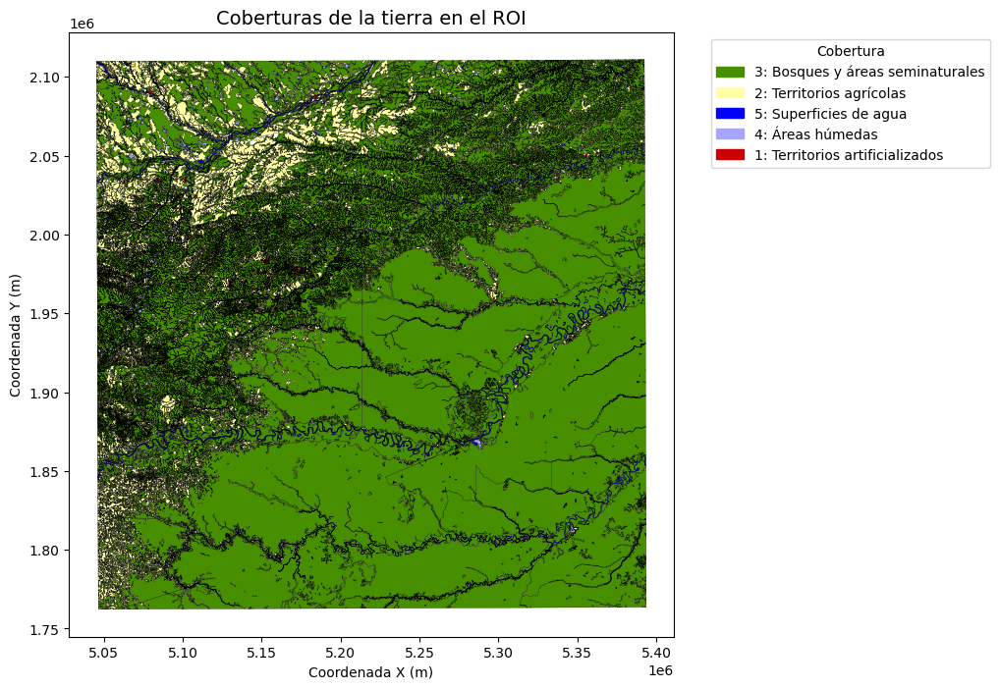

In [10]:
def visualize_land_cover(LandUseROI, column_name='nivel_1'):
    # Cargar la capa geoespacial
    gdf = gpd.read_file(LandUseROI)

    # Convertir valores de la columna 'nivel_1' a enteros
    gdf[column_name] = gdf[column_name].astype(str).str.strip()
    try:
        gdf[column_name] = gdf[column_name].astype(int)
    except ValueError:
        raise ValueError(f"⚠️ No se pueden convertir los valores de '{column_name}' a enteros. Valores encontrados: {gdf[column_name].unique()}")

    # Diccionario de etiquetas y colores
    cover_labels = {
        3: "Bosques y áreas seminaturales",
        2: "Territorios agrícolas",
        5: "Superficies de agua",
        4: "Áreas húmedas",
        1: "Territorios artificializados"
    }

    color_map = {
        3: "#478F00",  # Bosques
        2: "#FFFFA6",  # Territorios agrícolas
        5: "#0000F8",  # Superficies de agua
        4: "#A6A6FF",  # Áreas húmedas
        1: "#CC0000"   # Territorios artificializados
    }

    # Crear la visualización
    fig, ax = plt.subplots(figsize=(10, 8))
    legend_patches = []

    for cover, color in color_map.items():
        subset = gdf[gdf[column_name] == cover]
        if subset.empty:
            print(f"⚠️ No hay datos para la categoría {cover} ({cover_labels.get(cover, 'Desconocido')})")
            continue  # Evita errores si una categoría no está presente

        subset.plot(ax=ax, color=color, edgecolor='black', linewidth=0.2)
        legend_patches.append(mpatches.Patch(color=color, label=f"{cover}: {cover_labels.get(cover, 'Desconocido')}"))

    # Configuración del mapa
    ax.set_title("Coberturas de la tierra en el ROI", fontsize=14)
    ax.set_xlabel("Coordenada X (m)")
    ax.set_ylabel("Coordenada Y (m)")
    ax.legend(handles=legend_patches, title="Cobertura", bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.show()

# Uso del script
visualize_land_cover(LandUseROI)

##### 1.1.3 Clasificación

De acuerdo con la mayor proporción de coberturas dentro del área del proyecto, se asgina una categoría:

Bosques: 4
Territorios agrícolas: 3
Superficies de agua: 2
Áreas húmedas: 1
Otras categorías: 0

In [11]:
def visualize_reclassified_land_cover(LandUseROI, column_name='nivel_1'):
    # Cargar la capa geoespacial
    gdf = gpd.read_file(LandUseROI)

    # Convertir valores a enteros si es necesario
    gdf[column_name] = gdf[column_name].astype(str).str.strip()
    try:
        gdf[column_name] = gdf[column_name].astype(int)
    except ValueError:
        raise ValueError(f"⚠️ No se pueden convertir los valores de '{column_name}' a enteros. Valores encontrados: {gdf[column_name].unique()}")

    # Diccionario de reclasificación (asignación de puntajes)
    reclasificacion = {
        3: 4,  # Bosques
        2: 3,  # Territorios agrícolas
        5: 2,  # Superficies de agua
        4: 1   # Áreas húmedas
    }

    # Asignar el puntaje de reclasificación, y si no está en el diccionario, asignar 0
    gdf['Reclasificacion'] = gdf[column_name].map(reclasificacion).fillna(0).astype(int)

    return gdf

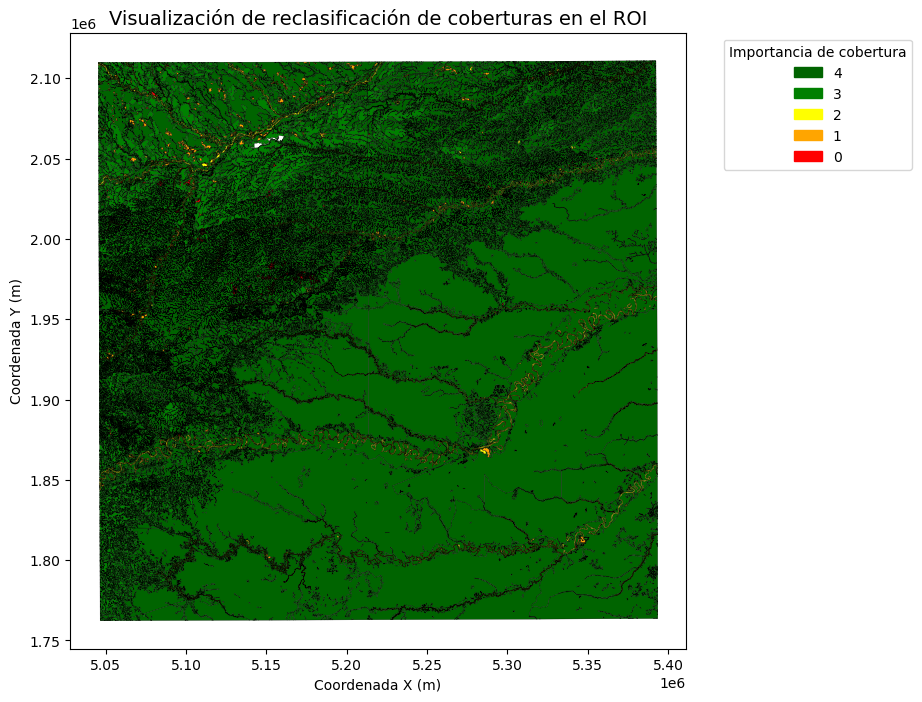

In [12]:
    gdf = visualize_reclassified_land_cover(LandUseROI)

    # Crear la visualización
    fig, ax = plt.subplots(figsize=(10, 8))
    legend_patches = []

    for score, color in color_map.items():
        subset = gdf[gdf['Reclasificacion'] == score]
        if subset.empty:
            print(f"⚠️ No hay datos para el puntaje {score}")
            continue  # Evita errores si una categoría no está presente

        subset.plot(ax=ax, color=color, edgecolor='black', linewidth=0.2)
        legend_patches.append(mpatches.Patch(color=color, label= score))

    # Configuración del mapa
    ax.set_title("Visualización de reclasificación de coberturas en el ROI", fontsize=14)
    ax.set_xlabel("Coordenada X (m)")
    ax.set_ylabel("Coordenada Y (m)")
    ax.legend(handles=legend_patches, title="Importancia de cobertura", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

In [13]:
gdf_reclasificado = visualize_reclassified_land_cover(LandUseROI)

print(gdf_reclasificado.head())

                                             leyenda  \
0                3.2.1.2.1. Herbazal abierto arenoso   
1                3.2.1.2.1. Herbazal abierto arenoso   
2  3.2.1.1.1.1.  Herbazal denso de tierra firme n...   
3  3.2.1.1.1.1.  Herbazal denso de tierra firme n...   
4         5.1.2. Lagunas, lagos y ciénagas naturales   

                          insumo apoyo confiabili  cambio  nivel_1 nivel_2  \
0  Landsat_2020_mediana_07042021  None         SI       1        3      32   
1  Landsat_2020_mediana_07042021  None         SI       1        3      32   
2  Landsat_2020_mediana_07042021  None         SI       1        3      32   
3  Landsat_2020_mediana_07042021  None         SI       1        3      32   
4  Landsat_2020_mediana_07042021  None         SI       1        5      51   

  nivel_3 nivel_4 nivel_5 nivel_6     area_ha nom_dpto      nom_mpio  \
0     321    3212   32121    None   52.740735  Vichada  La Primavera   
1     321    3212   32121    None  129.510036  Vic

##### 1.1.4 Rasterización

A continuación se presenta el proceso de rasterizado del resultado previo donde se definió una clasificación para las coberturas. 

✔️ Raster creado en: Data/landCover.tif


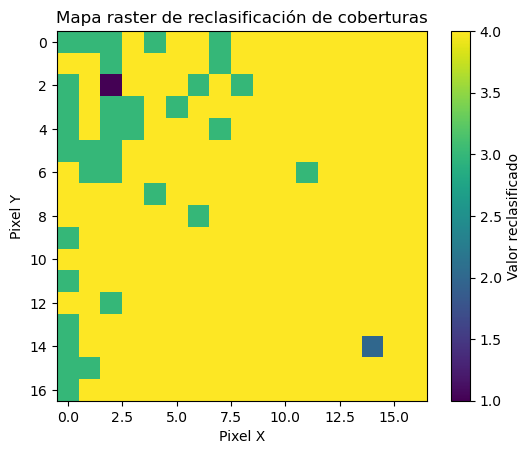

In [16]:
# 3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
resraster = 100  # Tamaño de píxel (en unidades del CRS: metros si es proyección UTM)
xmin, ymin, xmax, ymax = gdf_reclasificado.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(gdf_reclasificado.geometry, gdf_reclasificado['Reclasificacion'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/landCover.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='viridis')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa raster de reclasificación de coberturas")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()

### 2. Conexiones de transporte e infraestructura humana

#### 2.1 Vías

Se utiliza como insumo: Base de datos vectorial básica. Colombia. Escala 1:100.000. Año 2022 https://www.colombiaenmapas.gov.co/?e=-82.66306750976614,-1.472155764324179,-65.83201282227061,11.52294072264956,4686&b=igac&u=0&t=23&servicio=205 

In [20]:
#Insumos
RoadsProject = gpd.read_file("Data\\Vias_project_area.shp")
RoadsROI = gpd.read_file("Data\\Vias_roi.shp")

##### 2.1.1 Densidad de vías en el área del proyecto

Se desarrolla un script para saber cuál es la densidad de vías, definida en m² sobre km², dentro del área del proyecto establecida, en este caso el Resguardo Indígena Alto Unuma.

C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Límites de los Natural Breaks: [  0.          22.9854395   50.07452744 109.9828285  195.69627654]


C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


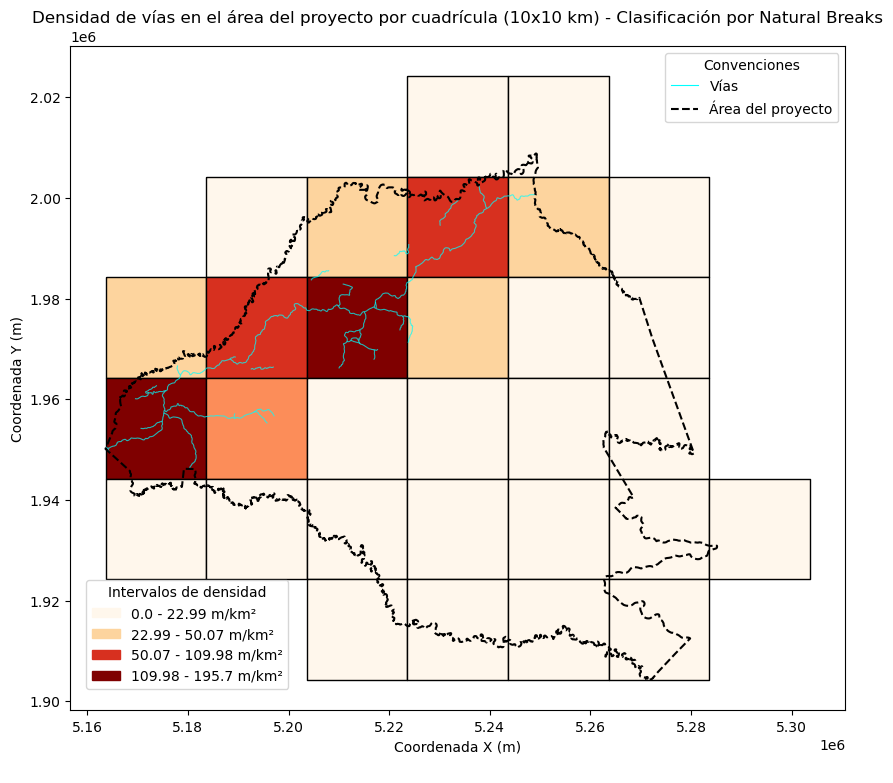

In [21]:
os.environ["OMP_NUM_THREADS"] = "1"

# ---- Definir límites del área del proyecto ----
# Se extraen los límites de la extensión del área del proyecto y el sistema de referencia (CRS)
bounds = ProjectArea.total_bounds
crs = ProjectArea.crs  # Sistema de referencia

# ---- Creación de la cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds

# Se generan las coordenadas de las columnas y filas de la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la cuadrícula ----
# Se filtran las celdas que intersetan con el área del proyecto
grid = grid[grid.intersects(ProjectArea.union_all())]
grid['id'] = grid.index  # Se asigna un ID único a cada celda

# ---- Recorte de las vías dentro de cada celda ----
# Se intersectan las vías con la cuadrícula para obtener solo las que están dentro de cada celda
RoadsProjectClip = gpd.overlay(RoadsProject, grid, how='intersection')

# ---- Cálculo de la longitud de vías por celda ----
# Se calcula la longitud de las vías en metros dentro de cada celda
RoadsProjectClip["longitud_via_m"] = RoadsProjectClip.geometry.length

# Se agrupa la información sumando la longitud total de vías por celda
RoadsProjectGrid = RoadsProjectClip.groupby("id")["longitud_via_m"].sum().reset_index()

# Se unen los datos de longitud de vías a la cuadrícula original
grid = grid.merge(RoadsProjectGrid, on="id", how="left").fillna(0)

# ---- Cálculo de la densidad de vías ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid["area_km2"] = (res / 1000) ** 2  # Convertir metros cuadrados a kilómetros cuadrados

# Se calcula la densidad de vías en cada celda (longitud de vías en metros por km²)
grid["densidad_vias"] = grid["longitud_via_m"] / grid["area_km2"]

# ---- Clasificación mediante Natural Breaks ----
# Se aplican los Natural Breaks para segmentar los valores de densidad en 5 categorías
nb = mc.NaturalBreaks(grid["densidad_vias"], k=5)
grid["clasificacion"] = nb.yb  # Asignar categorías a cada celda
breaks = nb.bins
print("Límites de los Natural Breaks:", nb.bins)

# ---- Visualización de los resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores para los 5 rangos
cmap = plt.get_cmap("OrRd", 5)  # Obtener la colormap con 5 colores

# Se plotea la cuadrícula con la clasificación por densidad de vías
grid.plot(column="densidad_vias", cmap=cmap, edgecolor="black",
          scheme="NaturalBreaks", legend=True, ax=ax)

# Se plotean las vías y el área del proyecto
RoadsProject.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="Vías")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(breaks[i], 2)} - {round(breaks[i+1], 2)} m/km²" for i in range(len(breaks)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
vias_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Vías")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.15, 0.10, 0.2, 0.2])  # Subimos de y=0.05 a y=0.15
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[vias_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de vías en el área del proyecto por cuadrícula (10x10 km) - Clasificación por Natural Breaks")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

###### 2.1.1.1 Cálculo de densidad de vías por desviación estándar

Este script calcula la media y la desviación estándar de la densidad de vías dentro de la cuadrícula y utiliza estos valores para definir límites de clasificación personalizados. Estos límites permiten una segmentación basada en la distribución estadística de los datos. La media representa el valor promedio de densidad de vías en las celdas, mientras que la desviación estándar indica la dispersión de los valores en relación con la media. Este método es útil para clasificar los datos en rangos que reflejan la variabilidad real de la distribución.

Media de densidad de vías: 23.24
Desviación estándar de densidad de vías: 51.28
Límites basados en media y desviación estándar: [0, 23.24, 74.52, 125.8, 195.7]


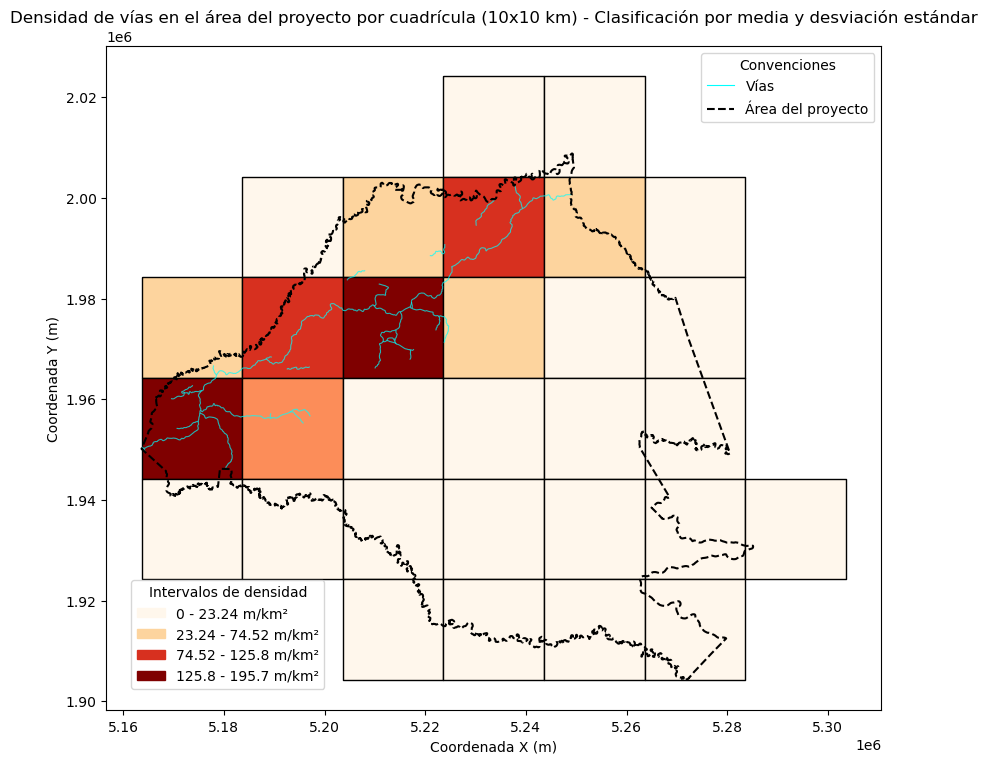

In [22]:
# ---- Cálculo de Media y Desviación Estándar ----
# Se calcula la media (promedio) de la densidad de vías y su desviación estándar.
mean_density = grid["densidad_vias"].mean()
std_density = grid["densidad_vias"].std()

# Se imprimen los valores calculados
print("Media de densidad de vías:", round(mean_density,2))
print("Desviación estándar de densidad de vías:", round(std_density,2))

# ---- Definición de límites ----
# Se definen los límites basados en la media y la desviación estándar:
# - Media - 1σ: un valor por debajo del promedio
# - Media: punto central de la distribución
# - Media + 1σ, +2σ, +3σ: valores crecientes que representan desviaciones mayores
bins = [
    0, 
    max(0, mean_density - std_density),  # Evita valores negativos
    mean_density, 
    mean_density + std_density, 
    mean_density + 2 * std_density,
    grid["densidad_vias"].max()
]

# Convertir `bins` a valores únicos, ordenados y asegurarse de que no haya duplicados
bins = sorted(set([round(b, 2) for b in bins]))

# Asegurar que haya al menos 2 valores distintos en `bins`
if len(bins) < 2:
    raise ValueError("Error: Los límites de clasificación contienen menos de dos valores únicos. Revisa los datos.")

print("Límites basados en media y desviación estándar:", bins)

# ---- Visualización de Resultados ----
# Se genera un gráfico que muestra la densidad de vías usando la clasificación definida por los límites
fig, ax = plt.subplots(figsize=(10, 10))

grid.plot(column="densidad_vias", cmap=cmap, edgecolor="black",
          scheme="UserDefined", classification_kwds={"bins": bins},
          legend=True, ax=ax)

# Se plotean las vías y el área del proyecto
RoadsProject.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="Vías")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{bins[i]} - {bins[i+1]} m/km²" for i in range(len(bins)-1)]
colors = plt.get_cmap(cmap, len(labels))(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para las vías y el área del proyecto
vias_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Vías")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# Crear una segunda leyenda en un recuadro aparte
legend2 = fig.add_axes([0.15, 0.10, 0.2, 0.2])  # [x, y, ancho, alto]
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[vias_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de vías en el área del proyecto por cuadrícula (10x10 km) - Clasificación por media y desviación estándar")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.1.2 Densidad de vías en el ROI

Se realiza el mismo procedimiento anteriormente descrito, pero esta vez se tiene en cuenta en la visualización los límites definidos por medio de la media y la desviación estándar, para encontrar efectivamente las zonas espaciales que tengan mayor similitud a la situación en el área del proyecto.

📌 Valor máximo de densidad de vías: 946.39 metros/km²


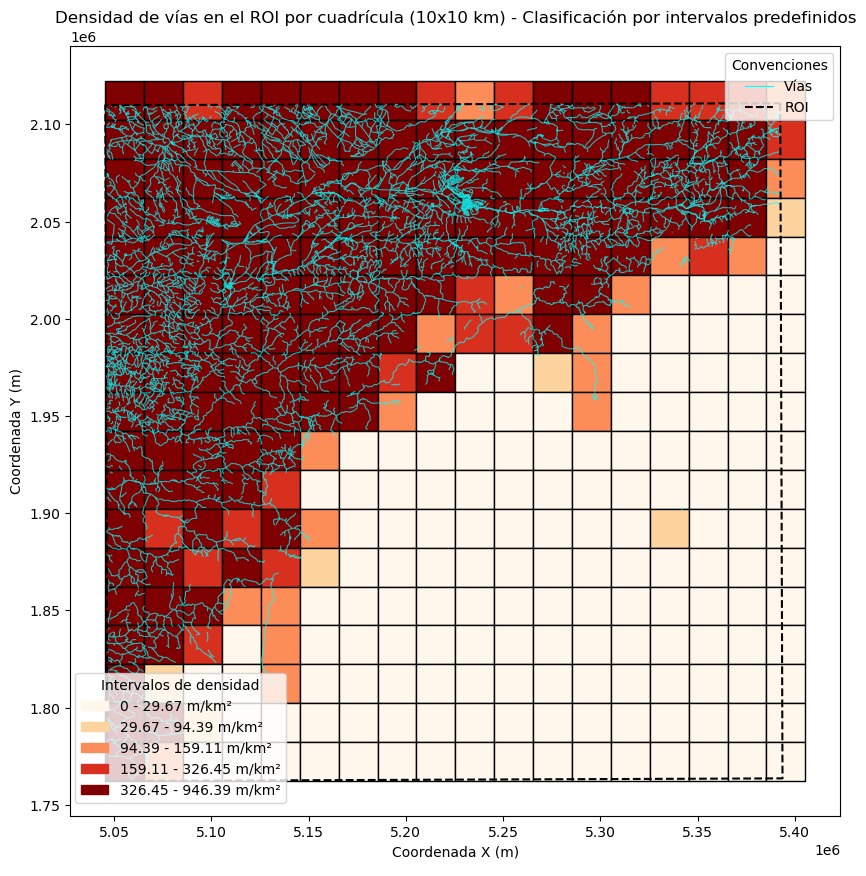

In [23]:
# ---- Definir Límites del Área de Interés ----
# Se extraen los límites espaciales y el sistema de referencia (CRS)
bounds_roi = ROI.total_bounds
crs = ROI.crs  # Sistema de referencia

# ---- Creación de la Cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds_roi

# Se generan las coordenadas de columnas y filas para la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid_roi = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la cuadrícula ----
# Se filtran las celdas que intersectan con el área de interés
grid_roi = grid_roi[grid_roi.intersects(ROI.union_all())]
grid_roi['id'] = grid_roi.index # Se asigna un ID único a cada celda

# ---- Recorte de vías dentro de cada celda ----
# Se intersectan las vías con la cuadrícula para obtener solo las que están dentro de cada celda
RoadsROIClip = gpd.overlay(RoadsROI, grid_roi, how='intersection')

# ---- Cálculo de la longitud de vías por celda ----
# Se calcula la longitud total de vías dentro de cada celda
RoadsROIClip["longitud_via_m"] = RoadsROIClip.geometry.length
RoadsROIClip = RoadsROIClip.groupby("id")["longitud_via_m"].sum().reset_index()

# Se unen los datos de longitud de vías a la cuadrícula original
grid_roi = grid_roi.merge(RoadsROIClip, on="id", how="left").fillna(0)

# ---- Cálculo de la densidad de vías ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid_roi["area_km2"] = (res / 1000) ** 2  # Convertir metros cuadrados a kilómetros cuadrados

# Calcular la densidad de vías (longitud de vías en metros por km²)
grid_roi["densidad_vias"] = grid_roi["longitud_via_m"] / grid_roi["area_km2"]

# ---- Obtener y mostrar el máximo valor de densidad de vías ----
max_density = grid_roi["densidad_vias"].max()
print(f"📌 Valor máximo de densidad de vías: {max_density:.2f} metros/km²")

# Solución: Ajustar el último bin
upper_limit = max(0, max_density)  # Asegura que el último bin sea mayor al máximo valor

# ---- Definición de límites de clasificación ----
# Se establecen los límites de clasificación utilizando intervalos definidos previamente
natural_breaks_bins = [0, 29.668134470649555, 94.38788965344989, 159.10764483625024, 326.45028819115976, upper_limit]

# ---- Visualización de Resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores
cmap = plt.get_cmap("OrRd", len(natural_breaks_bins) - 1)

# Se plotea la cuadrícula con la clasificación definida
grid_roi.plot(column="densidad_vias", cmap=cmap, edgecolor="black",
              legend=True, ax=ax, 
              scheme="UserDefined", classification_kwds={"bins": natural_breaks_bins},
              legend_kwds={'fmt': "{:.2f}"})

# Se plotean las vías y el área del proyecto
RoadsROI.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="Vías")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(natural_breaks_bins[i], 2)} - {round(natural_breaks_bins[i+1], 2)} m/km²" 
          for i in range(len(natural_breaks_bins)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
vias_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Vías")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria**
legend2 = fig.add_axes([0.15, 0.06, 0.2, 0.2])  
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[vias_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de vías en el ROI por cuadrícula (10x10 km) - Clasificación por intervalos predefinidos")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.1.3 Clasificación

Una vez se han definido los intervalos, se clasifica la densidad de vías del ROI según los límites definidos para el área del proyecto. Se asigna una clase a cada celda en función de la densidad de vías, con valores del 0 a 4.

In [24]:
# ---- Copia del GeoDataFrame ----
# Se crea una copia del GeoDataFrame de la cuadrícula para trabajar con la clasificación
grid_class = grid_roi.copy()

# ---- Definición de límites y clases ----
# Se establecen los límites de densidad de vías y sus respectivas categorías (de 0 a 4)
bins = [0, 29.668134470649555, 94.38788965344989, 159.10764483625024, 326.45028819115976, 1876]
values = [4, 3, 2, 1, 0]

# ---- Asignación de clases ----
# Se clasifica la densidad de vías en la cuadrícula utilizando los límites definidos
grid_class["clase_densidad"] = pd.cut(grid_class["densidad_vias"], bins=bins, labels=values, include_lowest=True)

# Se convierte la columna de clasificación a enteros
grid_class["clase_densidad"] = grid_class["clase_densidad"].astype(int)

# Verificar los valores generados
print("📌 Distribución de la clasificación:")
print(grid_class["clase_densidad"].value_counts().sort_index())


📌 Distribución de la clasificación:
clase_densidad
0     76
1     58
2     18
3     19
4    153
Name: count, dtype: int64


Una vez se ha definido la clase de densidad, se visualizan los resultados de la densidad de vías por cuadrícula.

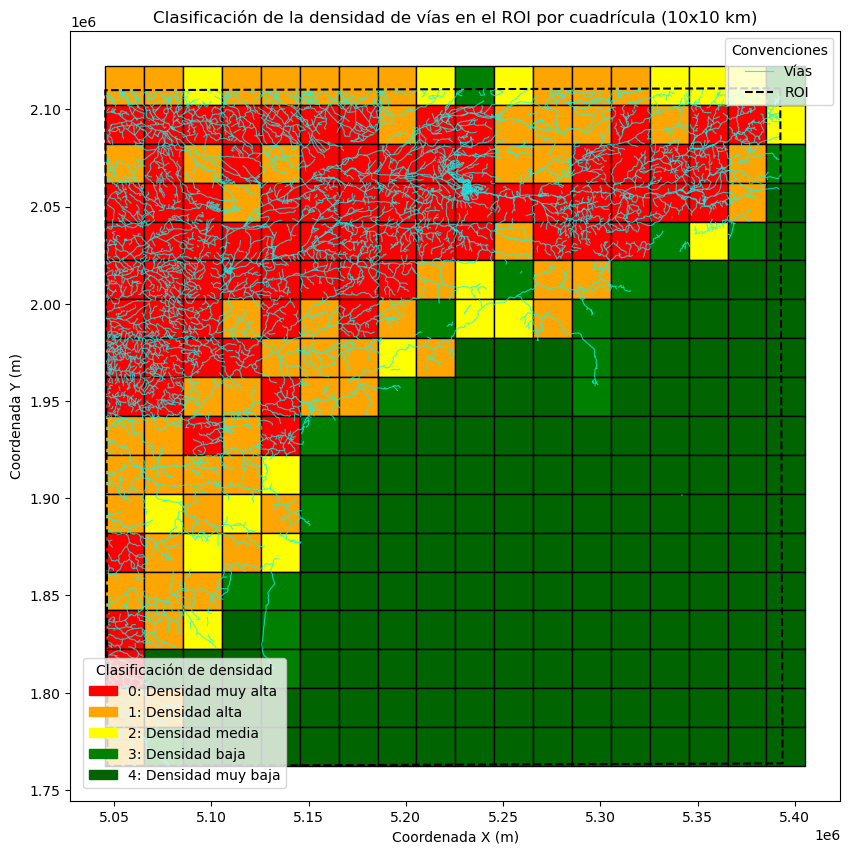

In [25]:
# Crear la visualización
fig, ax = plt.subplots(figsize=(10, 10))

# Aplicar la paleta de colores
grid_class.plot(color=grid_class["clase_densidad"].map(color_map), edgecolor="black", ax=ax)

# Ploteo de vías y área de interés (ROI)
RoadsROI.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="Vías")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para las clases de densidad
density_labels = {
    4: "4: Densidad muy baja",
    3: "3: Densidad baja",
    2: "2: Densidad media",
    1: "1: Densidad alta",
    0: "0: Densidad muy alta"
}

# Crear parches para la leyenda de clasificación de densidad
legend_patches = [mpatches.Patch(color=color_map[i], label=density_labels[i]) for i in sorted(color_map.keys())]

# Crear elementos de leyenda para vías y área del proyecto
vias_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Vías")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.15, 0.06, 0.2, 0.2])  # Subimos de y=0.05 a y=0.10
legend2.legend(handles=legend_patches, title="Clasificación de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área de interés
ax.legend(handles=[vias_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final del gráfico
ax.set_title("Clasificación de la densidad de vías en el ROI por cuadrícula (10x10 km)")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

In [26]:
print(grid_class.head())

                                            geometry  id  longitud_via_m  \
0  POLYGON ((5045385 2122308, 5065385 2122308, 50...   0    98565.626548   
1  POLYGON ((5045385 2102308, 5065385 2102308, 50...   1   212247.158849   
2  POLYGON ((5045385 2082308, 5065385 2082308, 50...   2   111866.611161   
3  POLYGON ((5045385 2062308, 5065385 2062308, 50...   3   191292.912836   
4  POLYGON ((5045385 2042308, 5065385 2042308, 50...   4   208207.754732   

   area_km2  densidad_vias  clase_densidad  
0     400.0     246.414066               1  
1     400.0     530.617897               0  
2     400.0     279.666528               1  
3     400.0     478.232282               0  
4     400.0     520.519387               0  


##### 2.1.4 Rasterización

A continuación se rasteriza el resultado previamente obtenido dobre le densidad de vías.

✔️ Raster creado en: Data/vias.tif


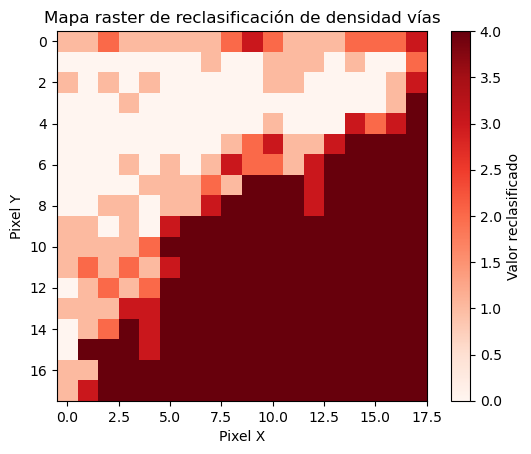

In [27]:
#3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
resraster = 100  # Tamaño de píxel (en unidades del CRS: metros si es proyección UTM)
xmin, ymin, xmax, ymax = grid_class.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(grid_class.geometry, grid_class['clase_densidad'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/vias.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa raster de reclasificación de densidad vías")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()

#### 2.2 Drenajes dobles

Se utiliza como insumo: Base de datos vectorial básica. Colombia. Escala 1:100.000. Año 2022 https://www.colombiaenmapas.gov.co/?e=-82.66306750976614,-1.472155764324179,-65.83201282227061,11.52294072264956,4686&b=igac&u=0&t=23&servicio=205

In [28]:
#Insumos
RiversProject = gpd.read_file("Data/Drenaje_Doble_project_area.shp")
RiversROI = gpd.read_file("Data/Drenaje_Doble_ROI.shp")

##### 2.2.1 Densidad de drenajes dobles para área del proyecto

A continuación se desarrolla un script para saber cuál es la densidad de drenajes dobles, definida en m²/km², dentro del área del proyecto establecida, en este caso el Resguardo Indígena Alto Unuma.

C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Límites de los Natural Breaks: [ 115.92504079  543.20267375 1001.44052294 1752.11161748 2727.20553387]


C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


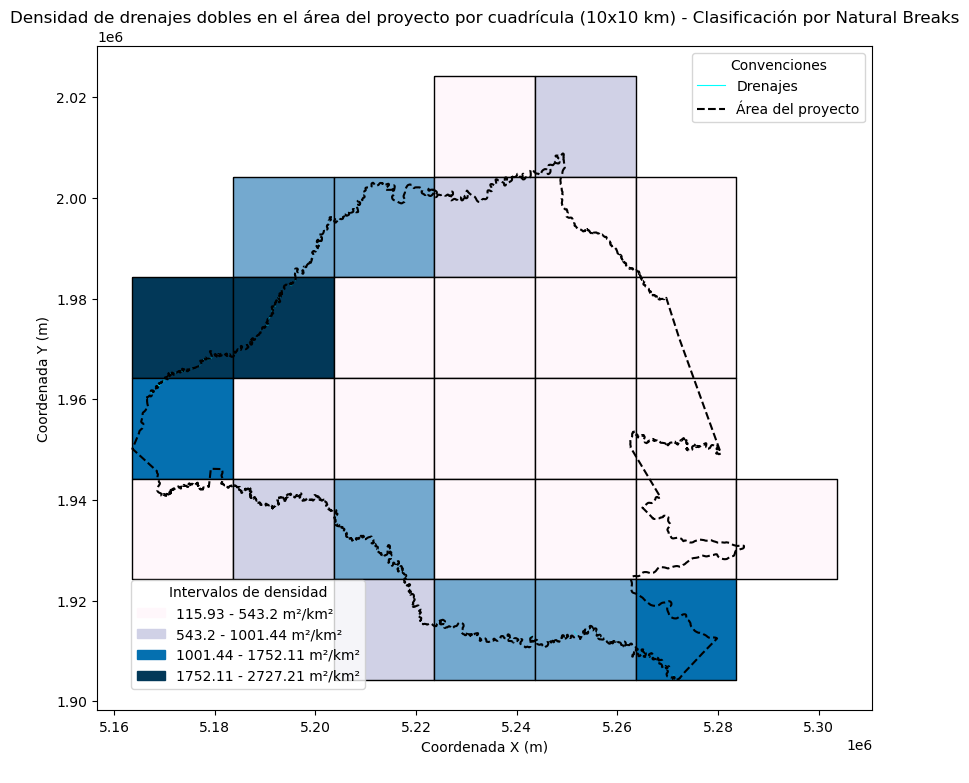

In [29]:
# ---- Definir límites del área del proyecto ----
# Se extraen los límites espaciales y el sistema de referencia (CRS)
bounds = ProjectArea.total_bounds  # [xmin, ymin, xmax, ymax]
crs = ProjectArea.crs  # Sistema de referencia

# ---- Creación de la cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds

# Se generan las coordenadas de columnas y filas para la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la Cuadrícula ----
# Se filtran las celdas que intersectan con el área del proyecto
grid = grid[grid.intersects(ProjectArea.union_all())]
grid['id'] = grid.index  # Se asigna un ID único a cada celda

# ---- Recorte de los Drenajes Dentro de Cada Celda ----
# Se intersectan los drenajes con la cuadrícula para obtener solo las partes dentro de cada celda
RiversProjectClip = gpd.overlay(RiversProject, grid, how='intersection')

# ---- Cálculo del Área de Drenajes por Celda ----
# Se calcula el área total de drenaje dentro de cada celda
RiversProjectClip["area_drenaje_m2"] = RiversProjectClip.geometry.area  # Área en metros cuadrados

RiversProjectGrid = RiversProjectClip.groupby("id")["area_drenaje_m2"].sum().reset_index()

# Se unen los datos de área de drenajes a la cuadrícula original
grid = grid.merge(RiversProjectGrid, on="id", how="left").fillna(0)

# ---- Cálculo de la Densidad de Drenajes ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid["area_km2"] = (res / 1000) ** 2

# Se calcula la densidad de drenajes en cada celda
grid["densidad_drenajes"] = grid["area_drenaje_m2"] / grid["area_km2"]

# ---- Clasificación mediante Natural Breaks ----
# Se aplican Natural Breaks para segmentar los valores de densidad en 5 categorías
nb = mc.NaturalBreaks(grid["densidad_drenajes"], k=5)
grid["clasificacion"] = nb.yb  # Asignar categorías a cada celda
breaks = nb.bins
print("Límites de los Natural Breaks:", nb.bins)

# ---- Visualización de Resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores para los 5 rangos
cmap = plt.get_cmap("PuBu", 5)  # Obtener la colormap con 5 colores

# Se plotea la cuadrícula con la clasificación definida por densidad de drenajes
grid.plot(column="densidad_drenajes", cmap=cmap, edgecolor="black",
          scheme="NaturalBreaks", k=5, legend=True, ax=ax)

# Se plotean los drenajes en color cian
RiversProject.plot(ax=ax, color="cyan", alpha=0.7, label="Drenajes")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(breaks[i], 2)} - {round(breaks[i+1], 2)} m²/km²" for i in range(len(breaks)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
drenajes_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Drenajes")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.2, 0.10, 0.2, 0.2])  # Subimos de y=0.05 a y=0.15
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[drenajes_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de drenajes dobles en el área del proyecto por cuadrícula (10x10 km) - Clasificación por Natural Breaks")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

###### 2.2.1.1 Cálculo de densidad de drenajes dobles por desviación estándar

Este script calcula la media y la desviación estándar de la densidad de drenajes dentro de la cuadrícula y utiliza estos valores para definir límites de clasificación personalizados. Estos límites permiten una segmentación basada en la distribución estadística de los datos. La media representa el valor promedio de densidad de drenajes en las celdas, mientras que la desviación estándar indica la dispersión de los valores en relación con la media. Este método es útil para clasificar los datos en rangos que reflejan la variabilidad real de la distribución.

Media de densidad de drenajes: 462.36466103792554
Desviación estándar de densidad de drenajes: 740.1192009623071
Límites Basados en media y desviación estándar: [0, 462.36, 1202.48, 1942.6, 2727.21]


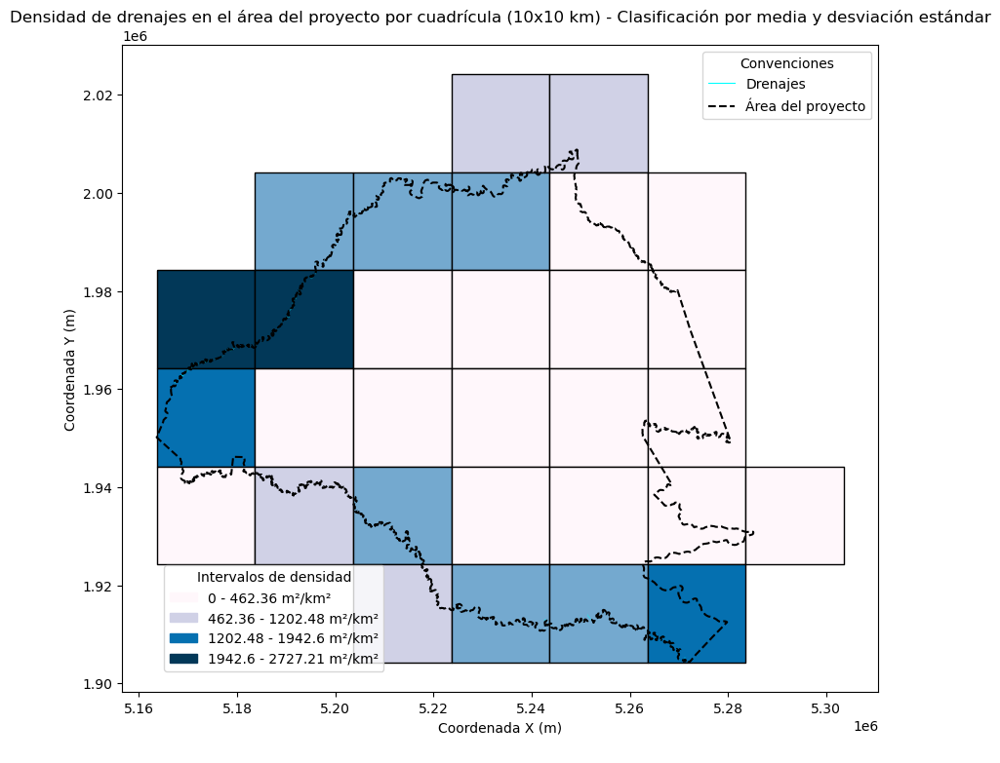

In [31]:
# ---- Cálculo de Media y Desviación Estándar ----
# Se calcula la media (promedio) de la densidad de drenajes y su desviación estándar.
mean_density = grid["densidad_drenajes"].mean()
std_density = grid["densidad_drenajes"].std()

# Se imprimen los valores calculados
print("Media de densidad de drenajes:", mean_density)
print("Desviación estándar de densidad de drenajes:", std_density)

# ---- Definición de Límites Manuales ----
# Se definen los límites basados en la media y la desviación estándar:
# - Media - 1σ: Un valor por debajo del promedio
# - Media: Punto central de la distribución
# - Media + 1σ, +2σ, +3σ: Valores crecientes que representan desviaciones mayores
bins = [0, 
        mean_density - std_density, 
        mean_density, 
        mean_density + std_density, 
        mean_density + 2 * std_density, 
        grid["densidad_drenajes"].max()]

# Convertir 'bins' a valores únicos, ordenados y asegurarse de que no haya duplicados
bins = sorted(set([round(b, 2) for b in bins if b >= 0]))

# Asegurar que haya al menos 2 valores distintos en `bins`
if len(bins) < 2:
    raise ValueError("Error: Los límites de clasificación contienen menos de dos valores únicos. Revisa los datos.")

# Se imprimen los límites definidos
print("Límites Basados en media y desviación estándar:", bins)

# ---- Visualización de Resultados ----
# Se genera un gráfico que muestra la densidad de drenajes usando la clasificación definida por los límites
fig, ax = plt.subplots(figsize=(10, 10))

grid.plot(column="densidad_drenajes", cmap=cmap, edgecolor="black",
          scheme="UserDefined", classification_kwds={"bins": bins},
          legend=True, ax=ax)

# Se plotean los drenajes en color cian
RiversProject.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="Drenajes")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{bins[i]} - {bins[i+1]} m²/km²" for i in range(len(bins)-1)]
colors = plt.get_cmap(cmap, len(labels))(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para las vías y el área del proyecto
drenajes_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Drenajes")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# Crear una segunda leyenda en un recuadro aparte
legend2 = fig.add_axes([0.2, 0.10, 0.2, 0.2])  # [x, y, ancho, alto]
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[drenajes_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de drenajes en el área del proyecto por cuadrícula (10x10 km) - Clasificación por media y desviación estándar")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.2.2 Densidad de drenajes dobles en el ROI

Se realiza el mismo procedimiento anteriormente descrito, pero esta vez se tiene en cuenta en la visualización los límites definidos por medio de la media y la desviación estándar, para encontrar efectivamente las zonas espaciales que tengan mayor similitud a la situación en el área del proyecto.

📌 Valor máximo de densidad de drenajes: 81004.44 m²/km²


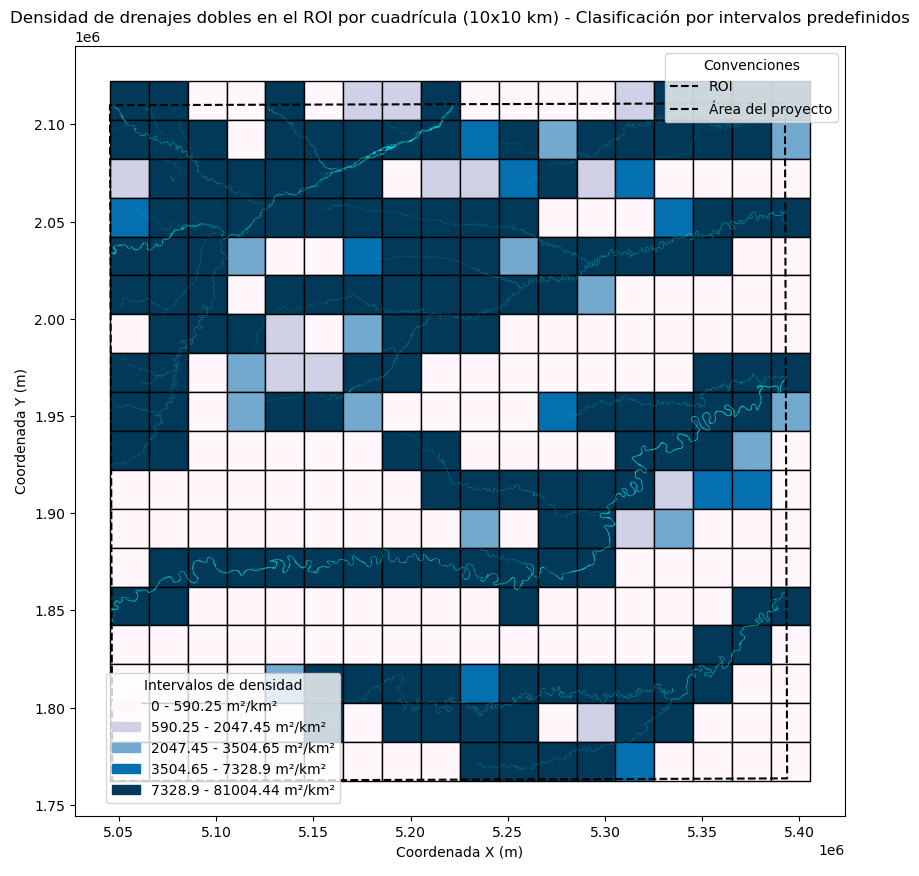

In [32]:
# ---- Definir Límites del Área de Interés ----
# Se extraen los límites espaciales y el sistema de referencia (CRS)
bounds_roi = ROI.total_bounds  # [xmin, ymin, xmax, ymax]
crs = ROI.crs  # Sistema de referencia

# ---- Creación de la Cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds_roi

# Se generan las coordenadas de columnas y filas para la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid_roi = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la Cuadrícula ----
# Se filtran las celdas que intersectan con el área de interés
grid_roi = grid_roi[grid_roi.intersects(ROI.union_all())]
grid_roi['id'] = grid_roi.index  # Se asigna un ID único a cada celda

# ---- Recorte de los Drenajes Dentro de Cada Celda ----
# Se intersectan los drenajes con la cuadrícula para obtener solo las partes dentro de cada celda
RiversROIClip = gpd.overlay(RiversROI, grid_roi, how='intersection')

# ---- Cálculo del Área de Drenajes por Celda ----
# Se calcula el área total de drenaje dentro de cada celda
RiversROIClip["area_drenaje_m2"] = RiversROIClip.geometry.area  # Área en metros cuadrados

RiversROIClip = RiversROIClip.groupby("id")["area_drenaje_m2"].sum().reset_index()

# Se unen los datos de área de drenajes a la cuadrícula original
grid_roi = grid_roi.merge(RiversROIClip, on="id", how="left").fillna(0)

# ---- Cálculo de la Densidad de Drenajes ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid_roi["area_km2"] = (res / 1000) ** 2

# Se calcula la densidad de drenajes en cada celda
grid_roi["densidad_drenajes"] = grid_roi["area_drenaje_m2"] / grid_roi["area_km2"]

# ---- Obtener y Mostrar el Máximo Valor de Densidad de Drenajes ----
max_density = grid_roi["densidad_drenajes"].max()
print(f"📌 Valor máximo de densidad de drenajes: {max_density:.2f} m²/km²")

# Solución: Ajustar el último bin
upper_limit = max(0, max_density)  # Asegura que el último bin sea mayor al máximo valor

# ---- Definición de Límites de Clasificación ----
# Se establecen los límites de clasificación utilizando Natural Breaks predefinidos
natural_breaks_bins = [0, 590.2527587718203, 2047.4525604358778, 3504.652362099935, 7328.896180867518, upper_limit]

# ---- Visualización de Resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores
cmap = plt.get_cmap("PuBu", len(natural_breaks_bins) - 1)

# Se plotea la cuadrícula con la clasificación definida por densidad de drenajes
grid_roi.plot(column="densidad_drenajes", cmap=cmap, edgecolor="black",
              legend=True, ax=ax, 
              scheme="UserDefined", classification_kwds={"bins": natural_breaks_bins},
              legend_kwds={'fmt': "{:.2f}"})

# Se plotean los drenajes en color cian
RiversROI.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label= "Drenajes")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label= "ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(natural_breaks_bins[i], 2)} - {round(natural_breaks_bins[i+1], 2)} m²/km²" 
          for i in range(len(natural_breaks_bins)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
drenajes_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Drenajes")
drenajes_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria**
legend2 = fig.add_axes([0.2, 0.06, 0.2, 0.2])  
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[drenajes_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de drenajes dobles en el ROI por cuadrícula (10x10 km) - Clasificación por intervalos predefinidos")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.2.3 Clasificación

Una vez se han definido los intervalos, se clasifica la densidad de drenajes del ROI según los límites definidos para el área del proyecto. Se asigna una clase a cada celda en función de la densidad de drenajes, con valores del 0 al 4.

In [33]:
# ---- Copia del GeoDataFrame ----
# Se crea una copia del GeoDataFrame de la cuadrícula para trabajar con la clasificación
grid_class = grid_roi.copy()

# ---- Definición de Límites y Clases ----
# Se establecen los límites de densidad de drenajes y sus respectivas categorías (de 0 a 4)
bins = [0, 590.2527587718203, 2047.4525604358778, 3504.652362099935, 7328.896180867518, 170494]
values = [4, 3, 2, 1, 0]  # Asignación de clases de mayor a menor densidad

# ---- Asignación de Clases ----
# Se clasifica la densidad de drenajes en la cuadrícula utilizando los límites definidos
grid_class["clase_densidad"] = pd.cut(grid_class["densidad_drenajes"], bins=bins, labels=values, include_lowest=True)

# Se convierte la columna de clasificación a enteros
grid_class["clase_densidad"] = grid_class["clase_densidad"].astype(int)

# ---- Verificación de la Clasificación ----
# Se muestra la distribución de la clasificación generada
print("📌 Distribución de la clasificación:")
print(grid_class["clase_densidad"].value_counts().sort_index())

📌 Distribución de la clasificación:
clase_densidad
0     95
1     46
2     11
3     14
4    158
Name: count, dtype: int64


Una vez se ha definido la clase de densidad, se visualizan los resultados de la densidad de drenajes por cuadrícula.

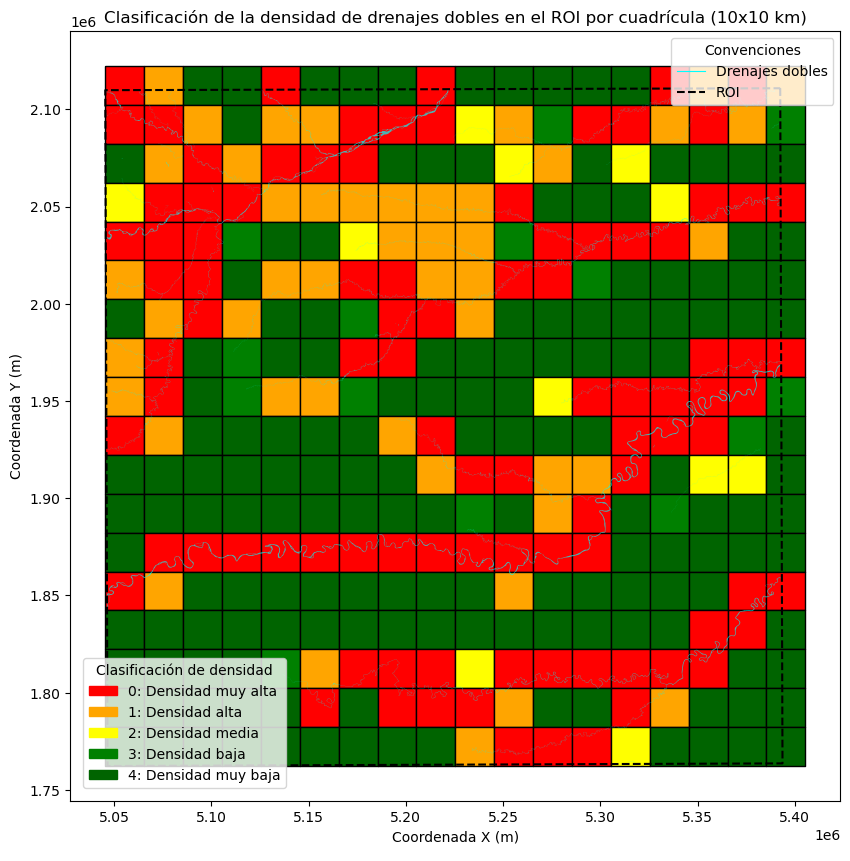

In [34]:
# ---- Creación del Gráfico ----
fig, ax = plt.subplots(figsize=(10, 10))

# Se aplica la paleta de colores definida a la cuadrícula
grid_class.plot(color=grid_class["clase_densidad"].map(color_map), edgecolor="black", ax=ax)

# Ploteo de vías y área de interés (ROI)
RiversROI.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="Drenajes dobles")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para las clases de densidad
density_labels = {
    4: "4: Densidad muy baja",
    3: "3: Densidad baja",
    2: "2: Densidad media",
    1: "1: Densidad alta",
    0: "0: Densidad muy alta"
}

# Crear parches para la leyenda de clasificación de densidad
legend_patches = [mpatches.Patch(color=color_map[i], label=density_labels[i]) for i in sorted(color_map.keys())]

# Crear elementos de leyenda para vías y área del proyecto
drenajes_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Drenajes dobles")
ROI_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.15, 0.06, 0.2, 0.2])  # Subimos de y=0.05 a y=0.10
legend2.legend(handles=legend_patches, title="Clasificación de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área de interés
ax.legend(handles=[drenajes_legend, ROI_legend], title="Convenciones", loc='upper right')

# Configuración final del gráfico
ax.set_title("Clasificación de la densidad de drenajes dobles en el ROI por cuadrícula (10x10 km)")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.2.4 Rasterización

A continuación se realiza la rasterización de los resultados previamente clasificados en cuanto a densidad de drenajes dobles.

✔️ Raster creado en: Data/Drenajes_dobles.tif


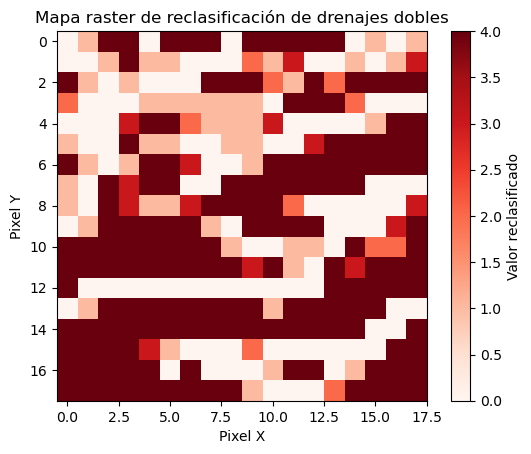

In [35]:
#3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
xmin, ymin, xmax, ymax = grid_class.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(grid_class.geometry, grid_class['clase_densidad'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/Drenajes_dobles.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa raster de reclasificación de drenajes dobles")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()

#### 2.3 Asentamientos humanos

Se utiliza como insumo: DIVIPOLA - Códigos cabeceras - Centros poblados https://www.datos.gov.co/Mapas-Nacionales/DIVIPOLA-C-digos-cabeceras-Centros-poblados/xaxy-8nri/about_data

In [36]:
#Insumos
SettlementsProject = gpd.read_file("Data/Rangos_CC_Project_area.shp")
SettlementsROI = gpd.read_file("Data/Rangos_CC_ROI.shp")

##### 2.3.1 Proximidad a asentamientos humanos en el área del proyecto

Para la determinación de la proximidad de los asentamientos humanos se utiliza la metodología propuesta por Molina-González et. al (2018), donde menciona que para los centros poblados se realiza primero un procesamiento de distancia euclidiana y posteriormente una clasificación por intervalos geométricos. Entonces así se logra identificar cual es la categoría que mayor tiene presencia en el área del proyecto.

In [37]:
# ---- Asegurar consistencia en el sistema de referencia ----
# Se convierte el CRS de la capa de asentamientos al mismo sistema de referencia del área del proyecto
SettlementsProject = SettlementsProject.to_crs(ProjectArea.crs)

# ---- Cálculo del área de asentamientos ----
# Se calcula el área de cada polígono de asentamiento en metros cuadrados
SettlementsProject["area_m2"] = SettlementsProject.geometry.area

# ---- Sumar área total por categoría ----
# Se agrupa por categoría de asentamiento y se suma el área total
df_area_por_categoria = SettlementsProject.groupby("gridcode")["area_m2"].sum().reset_index()

# Se convierte el área de metros cuadrados a hectáreas
df_area_por_categoria["area_ha"] = df_area_por_categoria["area_m2"] / 1e4

# Se ordena la tabla de mayor a menor área ocupada
df_area_por_categoria = df_area_por_categoria.sort_values(by="area_ha", ascending=False)

# ---- Mostrar resultados ----
# Se imprime la tabla con las áreas calculadas
print("\n📌 Áreas de las categorías de asentamientos humanos dentro del área del proyecto:")
print(df_area_por_categoria)


📌 Áreas de las categorías de asentamientos humanos dentro del área del proyecto:
   gridcode       area_m2        area_ha
3         4  3.202241e+09  320224.068809
2         3  1.383697e+09  138369.691941
4         5  1.009590e+09  100958.993174
1         2  6.994646e+08   69946.456392
0         1  4.380723e+08   43807.226629


Este script visualiza la distribución de categorías de asentamientos humanos dentro del área del proyecto. Se usa una paleta de colores categórica para diferenciar las categorías de asentamiento y se genera una leyenda personalizada. 

La categoría 1 es la más próxima a asentamientos humanos y la 5, la más lejana.

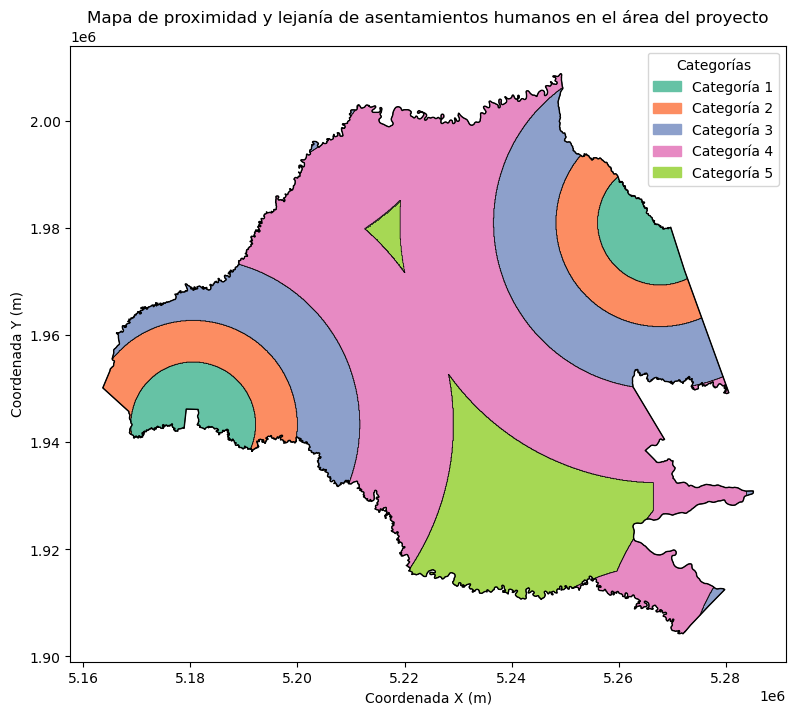

In [38]:
# ---- Definición de Paleta de Colores ----
# Se obtienen las categorías únicas y se asigna un color diferente a cada una
unique_categories = sorted(SettlementsProject["gridcode"].unique())  # Asegurar orden estable
colors = plt.cm.Set2(range(len(unique_categories)))  # Colores diferentes por categoría
cmap = mcolors.ListedColormap(colors)  # Usar solo estos colores
norm = mcolors.BoundaryNorm(unique_categories + [max(unique_categories) + 1], cmap.N)

# ---- Creación del Mapa ----
fig, ax = plt.subplots(figsize=(10, 8))

# Se dibuja el área del proyecto con un contorno negro
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1, label="Área del Proyecto")

# Se grafican los asentamientos con colores categóricos
SettlementsProject.plot(column="gridcode", cmap=cmap, norm=norm, ax=ax, edgecolor="black", linewidth=0.5)

# ---- Creación de Leyenda Personalizada ----
handles = [mpatches.Patch(color=cmap(norm(cat)), label=f"Categoría {cat}") for cat in unique_categories]
ax.legend(handles=handles, title="Categorías", loc="upper right")

# ---- Ajuste Final del Gráfico ----
ax.set_title("Mapa de proximidad y lejanía de asentamientos humanos en el área del proyecto")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.3.2 Proximidad a asentamientos humanos en el ROI

Este script muestra la presencia de las mismas categorías en el ROI, obtenidas a través del mismo procedimiento antes descrito.

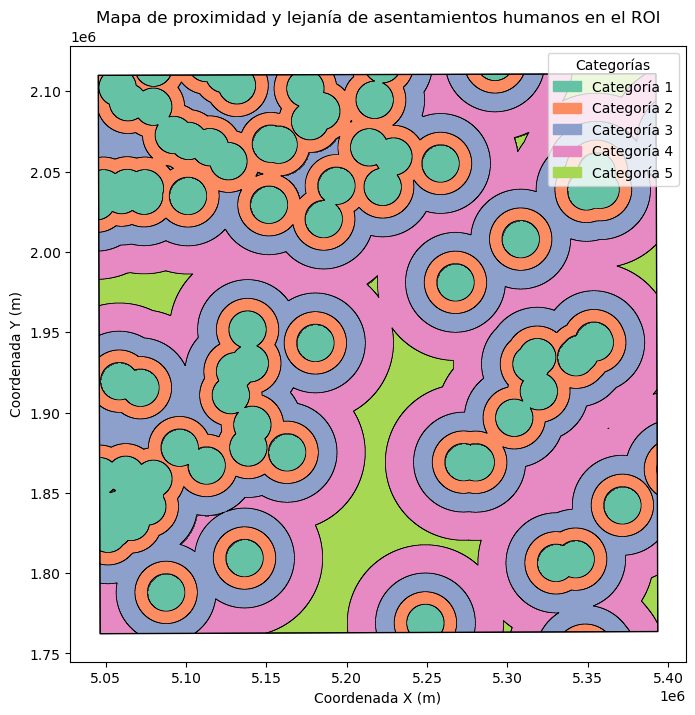

In [39]:
# ---- Definición de Paleta de Colores ----
# Se obtienen las categorías únicas y se asigna un color diferente a cada una
unique_categories = sorted(SettlementsROI["gridcode"].unique())  # Asegurar orden estable
colors = plt.cm.Set2(range(len(unique_categories)))  # Colores diferentes por categoría
cmap = mcolors.ListedColormap(colors)  # Usar solo estos colores
norm = mcolors.BoundaryNorm(unique_categories + [max(unique_categories) + 1], cmap.N)

# ---- Creación del Mapa ----
fig, ax = plt.subplots(figsize=(10, 8))

# Se dibuja el área del proyecto con un contorno negro
ROI.boundary.plot(ax=ax, color="black", linewidth=1, label="Área del Proyecto")

# Se grafican los asentamientos con colores categóricos
SettlementsROI.plot(column="gridcode", cmap=cmap, norm=norm, ax=ax, edgecolor="black", linewidth=0.5)

# ---- Creación de Leyenda Personalizada ----
handles = [mpatches.Patch(color=cmap(norm(cat)), label=f"Categoría {cat}") for cat in unique_categories]
ax.legend(handles=handles, title="Categorías", loc="upper right")

# ---- Ajuste Final del Gráfico ----
ax.set_title("Mapa de proximidad y lejanía de asentamientos humanos en el ROI")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 2.3.3 Clasificación

Este script ajusta la clasificación de asentamientos humanos en la región de interés (ROI) con base en la presencia de las mismas clasificaciones dentro del área del proyecto y visualiza la distribución con una paleta de colores representativa.

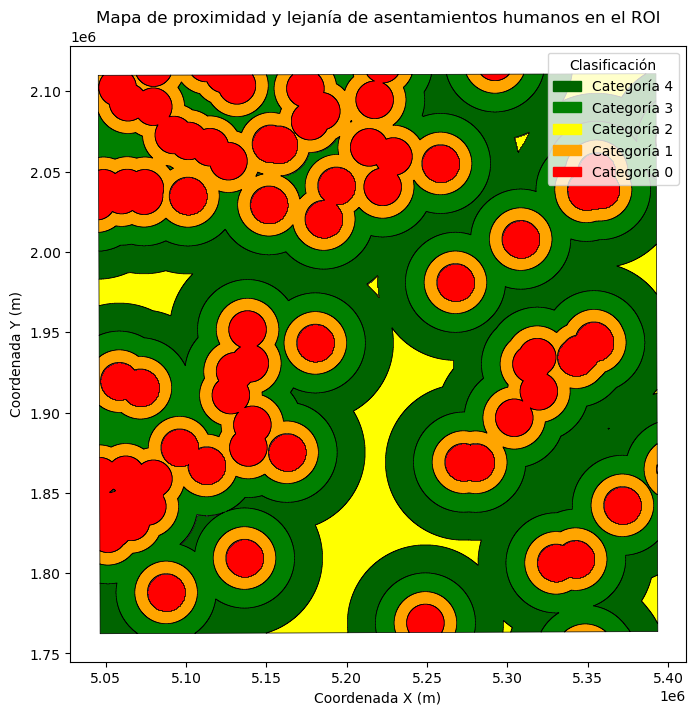

In [40]:
# ---- Ajuste de Clasificación ----
# Se reasignan los valores de clasificación en una nueva columna
SettlementsROI["nueva_clasificacion"] = SettlementsROI["gridcode"].map({
    4: 4,
    3: 3,
    5: 2,
    2: 1,
    1: 0
})

# ---- Creación del Gráfico ----
fig, ax = plt.subplots(figsize=(10, 8))

# Se grafican los asentamientos por categoría, aplicando la paleta de colores
total_patches = []
for value, color in color_map.items():
    SettlementsROI[SettlementsROI["nueva_clasificacion"] == value].plot(
        ax=ax, color=color, edgecolor="black", linewidth=0.5, label=f"Categoría {value}"
    )
    total_patches.append(mpatches.Patch(color=color, label=f"Categoría {value}"))

# ---- Creación de Leyenda Personalizada ----
ax.legend(handles=total_patches, title="Clasificación", loc="upper right")

# ---- Ajuste Final del Gráfico ----
ax.set_title("Mapa de proximidad y lejanía de asentamientos humanos en el ROI")

# ---- Mostrar el Mapa ----
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

In [41]:
print(SettlementsROI.head())

   Id  gridcode                                           geometry  \
0   2         1  POLYGON ((5283569.458 2110556.759, 5301169.458...   
1   3         1  POLYGON ((5069169.458 2109946.336, 5090569.458...   
2   4         3  POLYGON ((5191769.458 2110295.393, 5203969.458...   
3   5         2  POLYGON ((5274469.458 2110530.85, 5283569.458 ...   
4   6         5  POLYGON ((5334469.458 2093973.439, 5334469.458...   

   nueva_clasificacion  
0                    0  
1                    0  
2                    3  
3                    1  
4                    2  


##### 2.3.4 Rasterización

A continuación se rasteriza el resultado obtenido frente a la lejanía y cercanía de los asentamientos humanos.

✔️ Raster creado en: Data/asentamientos.tif


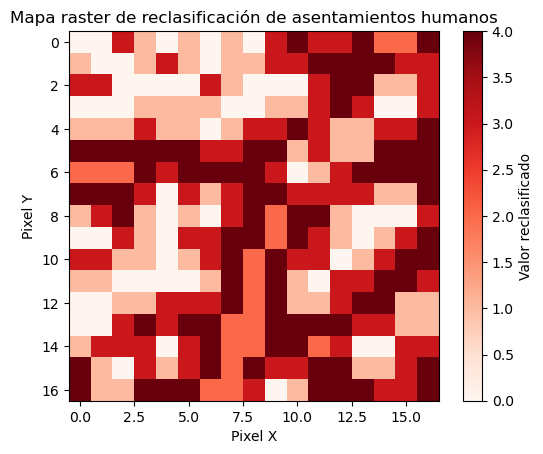

In [42]:
#3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
resraster = 100  # Tamaño de píxel (en unidades del CRS: metros si es proyección UTM)
xmin, ymin, xmax, ymax = SettlementsROI.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(SettlementsROI.geometry, SettlementsROI['nueva_clasificacion'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/asentamientos.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa raster de reclasificación de asentamientos humanos")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()

### 3. Políticas y regulaciones

#### 3.1 Humedales

Se utiliza como insumo: Áreas de importancia especial y ecosistemas estratégicos https://www.colombiaenmapas.gov.co/?e=-91.07859485351392,-7.914089216137852,-57.41648547852286,17.909127410706898,4686&b=igac&u=0&t=2&servicio=1454 

In [43]:
#Insumos
WetlandsProject = gpd.read_file("Data\\Humedales_project_area.shp")
WetlandsROI = gpd.read_file("Data\\Humedales_ROI.shp")

##### 3.1.1 Densidad de humedales para el área del proyecto

A continuación se desarrolla un script para saber cuál es la densidad de humedales, definida en m²/km², dentro del área del proyecto establecida, en este caso el Resguardo Indígena Alto Unuma.

C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Límites de los Natural Breaks: [ 24034.65568924  64863.73034442 144879.94146072 209794.1718682
 295101.88029915]


C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


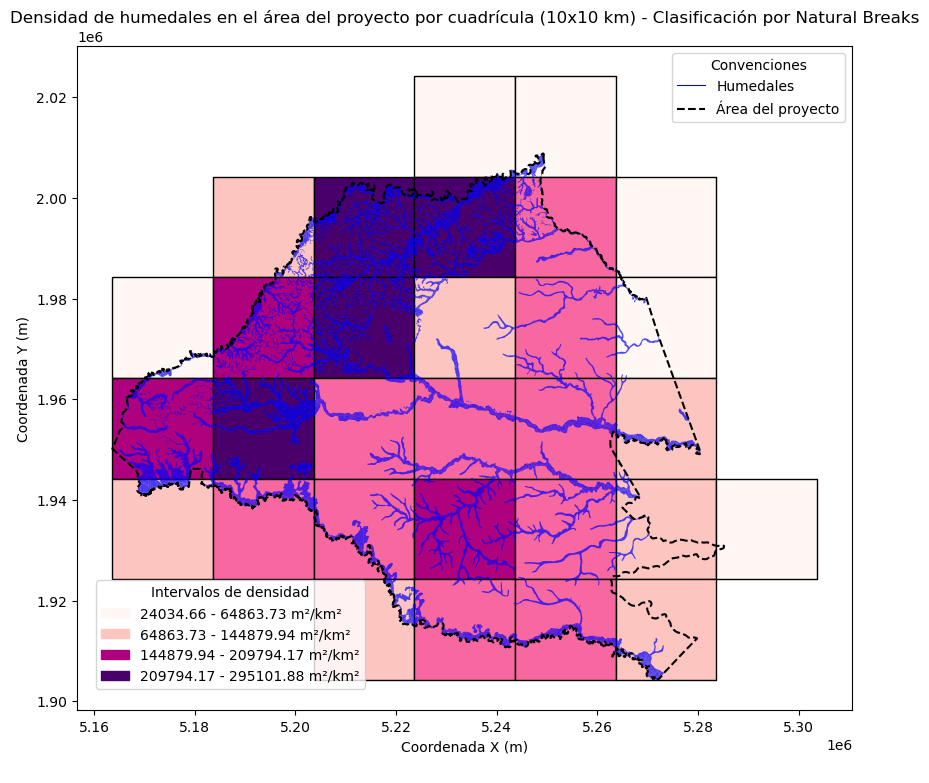

In [44]:
# ---- Definir límites del área del proyecto ----
# Se extraen los límites espaciales y el sistema de referencia (CRS)
bounds = ProjectArea.total_bounds  # [xmin, ymin, xmax, ymax]
crs = ProjectArea.crs  # Sistema de referencia

# ---- Creación de la cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds

# Se generan las coordenadas de columnas y filas para la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la Cuadrícula ----
# Se filtran las celdas que intersectan con el área del proyecto
grid = grid[grid.intersects(ProjectArea.union_all())]
grid['id'] = grid.index  # Se asigna un ID único a cada celda

# ---- Recorte de los humedales Dentro de Cada Celda ----
# Se intersectan los humedales con la cuadrícula para obtener solo las partes dentro de cada celda
WetlandsProjectClip = gpd.overlay(WetlandsProject, grid, how='intersection')

# ---- Cálculo del área de humedales por Celda ----
# Se calcula el área total de humedal dentro de cada celda
WetlandsProjectClip["area_humedal_m2"] = WetlandsProjectClip.geometry.area  # Área en metros cuadrados

WetlandsProjectGrid = WetlandsProjectClip.groupby("id")["area_humedal_m2"].sum().reset_index()

# Se unen los datos de área de humedales a la cuadrícula original
grid = grid.merge(WetlandsProjectGrid, on="id", how="left").fillna(0)

# ---- Cálculo de la densidad de humedales ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid["area_km2"] = (res / 1000) ** 2

# Se calcula la densidad de humedales en cada celda
grid["densidad_humedales"] = grid["area_humedal_m2"] / grid["area_km2"]

# ---- Clasificación mediante Natural Breaks ----
# Se aplican Natural Breaks para segmentar los valores de densidad en 5 categorías
nb = mc.NaturalBreaks(grid["densidad_humedales"], k=5)
grid["clasificacion"] = nb.yb  # Asignar categorías a cada celda
breaks = nb.bins
print("Límites de los Natural Breaks:", nb.bins)

# ---- Visualización de Resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores para los 5 rangos
cmap = plt.get_cmap("RdPu", 5)  # Obtener la colormap con 5 colores

# Se plotea la cuadrícula con la clasificación definida por densidad de humedales
grid.plot(column="densidad_humedales", cmap=cmap, edgecolor="black",
          scheme="NaturalBreaks", k=5, legend=True, ax=ax)

# Se plotean los humedales en color azul
WetlandsProject.plot(ax=ax, color="blue", alpha=0.7, label="Humedales")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(breaks[i], 2)} - {round(breaks[i+1], 2)} m²/km²" for i in range(len(breaks)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
humedales_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="Humedales")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.22, 0.10, 0.2, 0.2])  # Subimos de y=0.05 a y=0.15
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[humedales_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de humedales en el área del proyecto por cuadrícula (10x10 km) - Clasificación por Natural Breaks")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

###### 3.1.1.1 Cálculo de densidad de humedales por desviación estándar

Este script calcula la media y la desviación estándar de la densidad de humedales dentro de la cuadrícula y utiliza estos valores para definir límites de clasificación personalizados. Estos límites permiten una segmentación basada en la distribución estadística de los datos. La media representa el valor promedio de densidad de humedales en las celdas, mientras que la desviación estándar indica la dispersión de los valores en relación con la media. Este método es útil para clasificar los datos en rangos que reflejan la variabilidad real de la distribución.

Media de densidad de humedales: 105098.55508990043
Desviación estándar de densidad de humedales: 85622.81701944736
Límites basados en media y desviación estándar: [0, 19475.74, 105098.56, 190721.37, 276344.19, 295101.88]


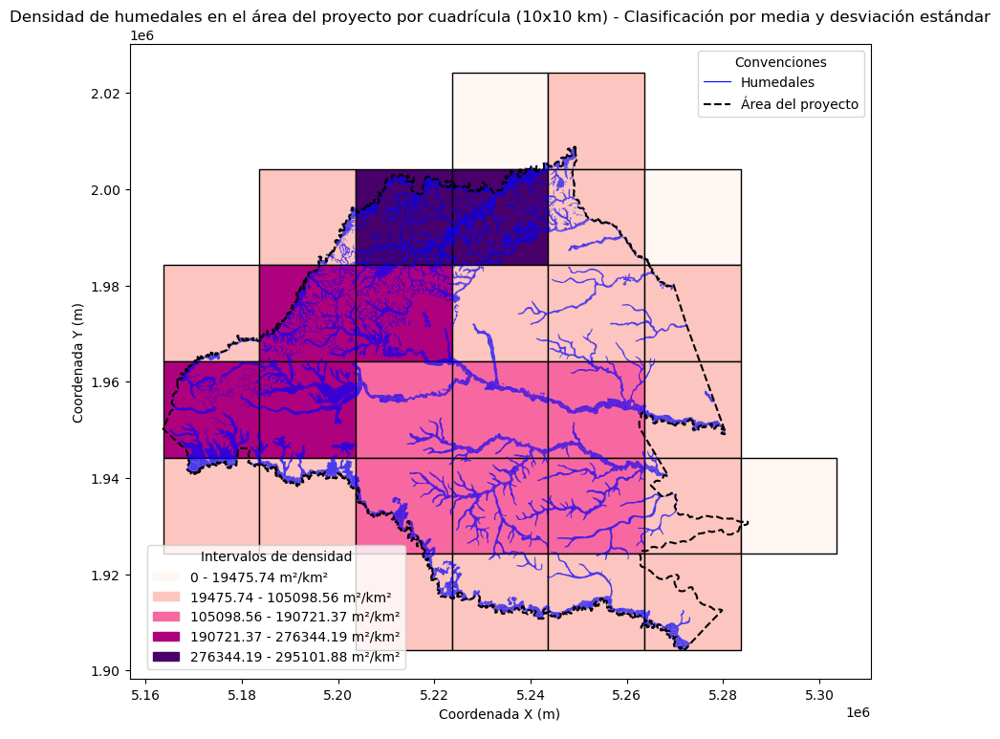

In [45]:
# ---- Cálculo de Media y Desviación Estándar ----
# Se calcula la media (promedio) de la densidad de humedales y su desviación estándar.
mean_density = grid["densidad_humedales"].mean()
std_density = grid["densidad_humedales"].std()

# Se imprimen los valores calculados
print("Media de densidad de humedales:", mean_density)
print("Desviación estándar de densidad de humedales:", std_density)

# ---- Definición de Límites Manuales ----
# Se definen los límites basados en la media y la desviación estándar:
# - Media - 1σ: Un valor por debajo del promedio
# - Media: Punto central de la distribución
# - Media + 1σ, +2σ, +3σ: Valores crecientes que representan desviaciones mayores
bins = [0, 
        mean_density - std_density, 
        mean_density, 
        mean_density + std_density, 
        mean_density + 2 * std_density, 
        grid["densidad_humedales"].max()]

# Convertir 'bins' a valores únicos, ordenados y asegurarse de que no haya duplicados
bins = sorted(set([round(b, 2) for b in bins if b >= 0]))

# Asegurar que haya al menos 2 valores distintos en `bins`
if len(bins) < 2:
    raise ValueError("Error: Los límites de clasificación contienen menos de dos valores únicos. Revisa los datos.")

# Se imprimen los límites definidos
print("Límites basados en media y desviación estándar:", bins)

# ---- Visualización de Resultados ----
# Se genera un gráfico que muestra la densidad de humedales usando la clasificación definida por los límites
fig, ax = plt.subplots(figsize=(10, 10))

grid.plot(column="densidad_humedales", cmap=cmap, edgecolor="black",
          scheme="UserDefined", classification_kwds={"bins": bins},
          legend=True, ax=ax)

# Se plotean los humedales en color cian
WetlandsProject.plot(ax=ax, color="blue", linewidth=0.8, alpha=0.7, label="Humedales")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{bins[i]} - {bins[i+1]} m²/km²" for i in range(len(bins)-1)]
colors = plt.get_cmap(cmap, len(labels))(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para las vías y el área del proyecto
humedales_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="Humedales")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# Crear una segunda leyenda en un recuadro aparte
legend2 = fig.add_axes([0.22, 0.11, 0.2, 0.2])  # [x, y, ancho, alto]
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[humedales_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de humedales en el área del proyecto por cuadrícula (10x10 km) - Clasificación por media y desviación estándar")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 3.1.2 Densidad de humedales en el ROI

Se realiza el mismo procedimiento anteriormente descrito, pero esta vez se tiene en cuenta en la visualización los límites definidos por medio de la media y la desviación estándar, para encontrar efectivamente las zonas espaciales que tengan mayor similitud a la situación en el área del proyecto.

📌 Valor máximo de densidad de humedales: 1000000.04 m²/km²


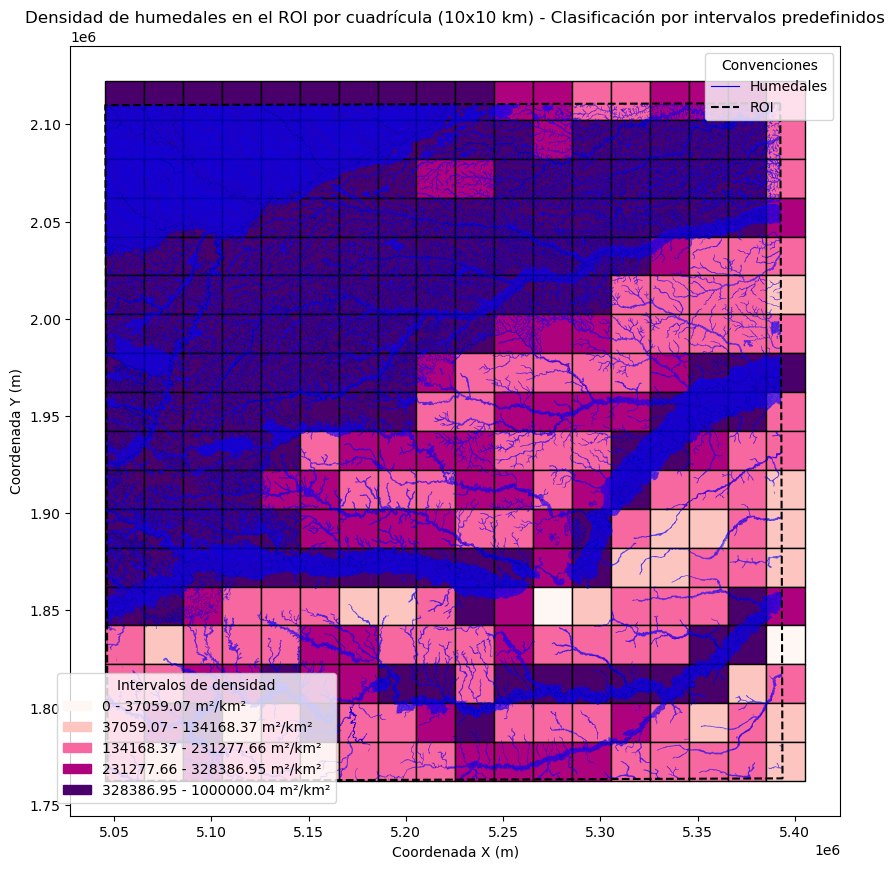

In [46]:
# ---- Definir Límites del Área de Interés ----
# Se extraen los límites espaciales y el sistema de referencia (CRS)
bounds_roi = ROI.total_bounds  # [xmin, ymin, xmax, ymax]
crs = ROI.crs  # Sistema de referencia

# ---- Creación de la Cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds_roi

# Se generan las coordenadas de columnas y filas para la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid_roi = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la Cuadrícula ----
# Se filtran las celdas que intersectan con el área de interés
grid_roi = grid_roi[grid_roi.intersects(ROI.union_all())]
grid_roi['id'] = grid_roi.index  # Se asigna un ID único a cada celda

# ---- Recorte de los humedales Dentro de Cada Celda ----
# Se intersectan los humedales con la cuadrícula para obtener solo las partes dentro de cada celda
WetlandsROIClip = gpd.overlay(WetlandsROI, grid_roi, how='intersection')

# ---- Cálculo del área de humedales por Celda ----
# Se calcula el área total de humedal dentro de cada celda
WetlandsROIClip["area_humedal_m2"] = WetlandsROIClip.geometry.area  # Área en metros cuadrados

WetlandsROIClip = WetlandsROIClip.groupby("id")["area_humedal_m2"].sum().reset_index()

# Se unen los datos de área de humedales a la cuadrícula original
grid_roi = grid_roi.merge(WetlandsROIClip, on="id", how="left").fillna(0)

# ---- Cálculo de la Densidad de humedales ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid_roi["area_km2"] = (res / 1000) ** 2

# Se calcula la densidad de humedales en cada celda
grid_roi["densidad_humedales"] = grid_roi["area_humedal_m2"] / grid_roi["area_km2"]

# ---- Obtener y Mostrar el Máximo Valor de Densidad de humedales ----
max_density = grid_roi["densidad_humedales"].max()
print(f"📌 Valor máximo de densidad de humedales: {max_density:.2f} m²/km²")

# Solución: Ajustar el último bin
upper_limit = max(0, max_density)  # Asegura que el último bin sea mayor al máximo valor

# ---- Definición de Límites de Clasificación ----
# Se establecen los límites de clasificación utilizando Natural Breaks predefinidos
natural_breaks_bins = [0, 37059.0748574444, 134168.368199872, 231277.6615423, 328386.954884727, upper_limit]

# ---- Visualización de Resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores
cmap = plt.get_cmap("RdPu", len(natural_breaks_bins) - 1)

# Se plotea la cuadrícula con la clasificación definida por densidad de humedales
grid_roi.plot(column="densidad_humedales", cmap=cmap, edgecolor="black",
              legend=True, ax=ax, 
              scheme="UserDefined", classification_kwds={"bins": natural_breaks_bins},
              legend_kwds={'fmt': "{:.2f}"})

# Se plotean los humedales en color azul
WetlandsROI.plot(ax=ax, color="blue", linewidth=0.8, alpha=0.7, label= "Humedales")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label= "ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(natural_breaks_bins[i], 2)} - {round(natural_breaks_bins[i+1], 2)} m²/km²" 
          for i in range(len(natural_breaks_bins)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
humedales_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="Humedales")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria**
legend2 = fig.add_axes([0.2, 0.06, 0.2, 0.2])  
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[humedales_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de humedales en el ROI por cuadrícula (10x10 km) - Clasificación por intervalos predefinidos")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 3.1.3 Clasificación

Una vez se han definido los intervalos, se clasifica la densidad de humedales del ROI según los límites definidos para el área del proyecto. Se asigna una clase a cada celda en función de la densidad de vías, con valores del 0 a 4.

In [47]:
# ---- Copia del GeoDataFrame ----
# Se crea una copia del GeoDataFrame de la cuadrícula para trabajar con la clasificación
grid_class = grid_roi.copy()

# ---- Definición de límites y clases ----
# Se establecen los límites de densidad de vías y sus respectivas categorías (de 0 a 4)
bins = [0, 37059.0748574444, 134168.368199872, 231277.6615423, 328386.954884727, 1000000.20]
values = [4, 3, 2, 1, 0]

# ---- Asignación de clases ----
# Se clasifica la densidad de vías en la cuadrícula utilizando los límites definidos
grid_class["clase_densidad"] = pd.cut(grid_class["densidad_humedales"], bins=bins, labels=values, include_lowest=True)

# Se convierte la columna de clasificación a enteros
grid_class["clase_densidad"] = grid_class["clase_densidad"].astype(int)

# Verificar los valores generados
print("📌 Distribución de la clasificación:")
print(grid_class["clase_densidad"].value_counts().sort_index())

📌 Distribución de la clasificación:
clase_densidad
0    105
1     60
2     53
3     85
4     21
Name: count, dtype: int64


Una vez se ha definido la clase de densidad, se visualizan los resultados de la densidad de humedales por cuadrícula.

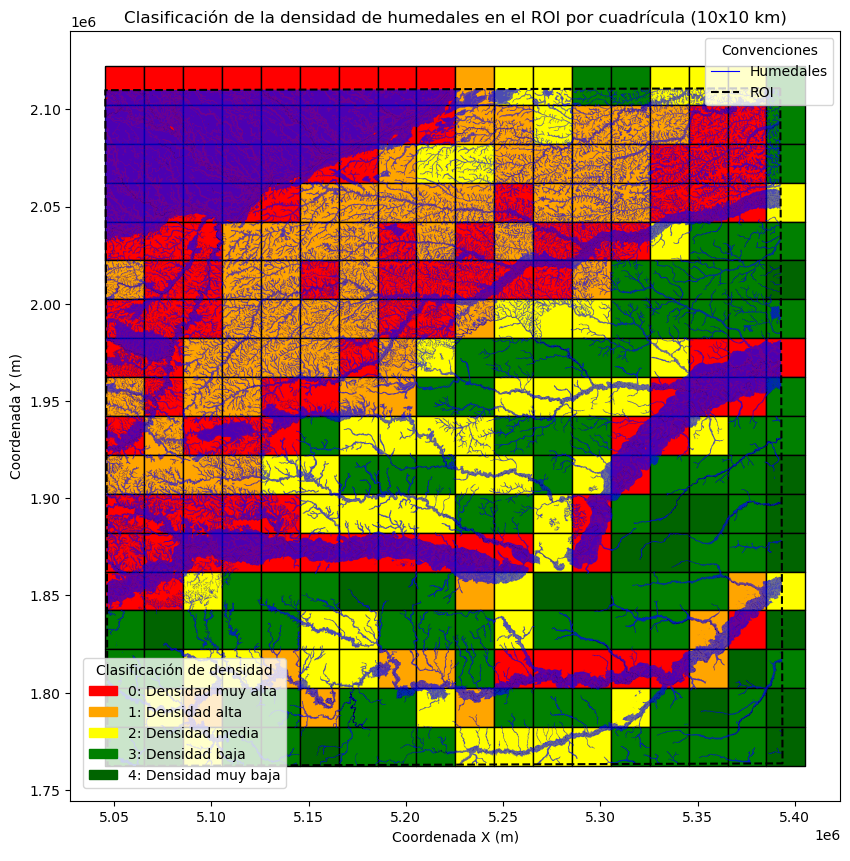

In [48]:
# Crear la visualización
fig, ax = plt.subplots(figsize=(10, 10))

# Aplicar la paleta de colores
grid_class.plot(color=grid_class["clase_densidad"].map(color_map), edgecolor="black", ax=ax)

# Ploteo de vías y área de interés (ROI)
WetlandsROI.plot(ax=ax, color="blue", linewidth=0.8, alpha=0.7, label="Humedales")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para las clases de densidad
density_labels = {
    4: "4: Densidad muy baja",
    3: "3: Densidad baja",
    2: "2: Densidad media",
    1: "1: Densidad alta",
    0: "0: Densidad muy alta"
}

# Crear parches para la leyenda de clasificación de densidad
legend_patches = [mpatches.Patch(color=color_map[i], label=density_labels[i]) for i in sorted(color_map.keys())]

# Crear elementos de leyenda para vías y área del proyecto
humedales_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="Humedales")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.15, 0.06, 0.2, 0.2])  # Subimos de y=0.05 a y=0.10
legend2.legend(handles=legend_patches, title="Clasificación de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área de interés
ax.legend(handles=[humedales_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final del gráfico
ax.set_title("Clasificación de la densidad de humedales en el ROI por cuadrícula (10x10 km)")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

In [49]:
print(grid_class.head())

                                            geometry  id  area_humedal_m2  \
0  POLYGON ((5045385 2122308, 5065385 2122308, 50...   0     1.506591e+08   
1  POLYGON ((5045385 2102308, 5065385 2102308, 50...   1     3.988143e+08   
2  POLYGON ((5045385 2082308, 5065385 2082308, 50...   2     3.974680e+08   
3  POLYGON ((5045385 2062308, 5065385 2062308, 50...   3     3.961217e+08   
4  POLYGON ((5045385 2042308, 5065385 2042308, 50...   4     2.112458e+08   

   area_km2  densidad_humedales  clase_densidad  
0     400.0       376647.842877               0  
1     400.0       997035.720558               0  
2     400.0       993669.979779               0  
3     400.0       990304.234871               0  
4     400.0       528114.497270               0  


##### 3.1.4 Rasterización

A continuación se rasteriza el resultado obtenido frente a la clasificación por densidad de humedales

✔️ Raster creado en: Data/humedales.tif


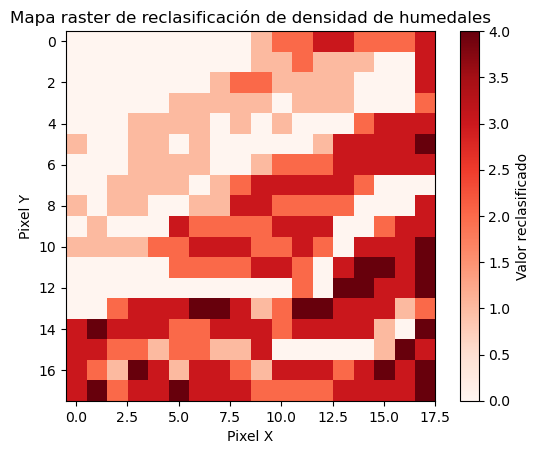

In [50]:
#3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
resraster = 100  # Tamaño de píxel (en unidades del CRS: metros si es proyección UTM)
xmin, ymin, xmax, ymax = grid_class.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(grid_class.geometry, grid_class['clase_densidad'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/humedales.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa raster de reclasificación de densidad de humedales")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()


#### 3.2 Rondas hídricas

Se utiliza como insumo: Base de datos vectorial básica. Colombia. Escala 1:100.000. Año 2022 https://www.colombiaenmapas.gov.co/?e=-82.66306750976614,-1.472155764324179,-65.83201282227061,11.52294072264956,4686&b=igac&u=0&t=23&servicio=205

##### 3.2.1 Rondas hídricas para el área del proyecto

A continuación se desarrolla un script para saber cuál es la cantidad área de rondas hídricas dentro del área del proyecto establecida, en este caso, el Resguardo Indígena Alto Unuma.

📊 Resumen de áreas:
            area_m2      area_ha
count  3.000000e+00     3.000000
mean   7.495972e+06   749.597229
std    3.540438e+06   354.043811
min    3.464251e+06   346.425123
25%    6.194946e+06   619.494607
50%    8.925641e+06   892.564090
75%    9.511833e+06   951.183282
max    1.009802e+07  1009.802474
📊 Área total de las rondas hídricas: 22487916.88 m²
📊 Área total de las rondas hídricas en hectáreas: 2248.79 ha


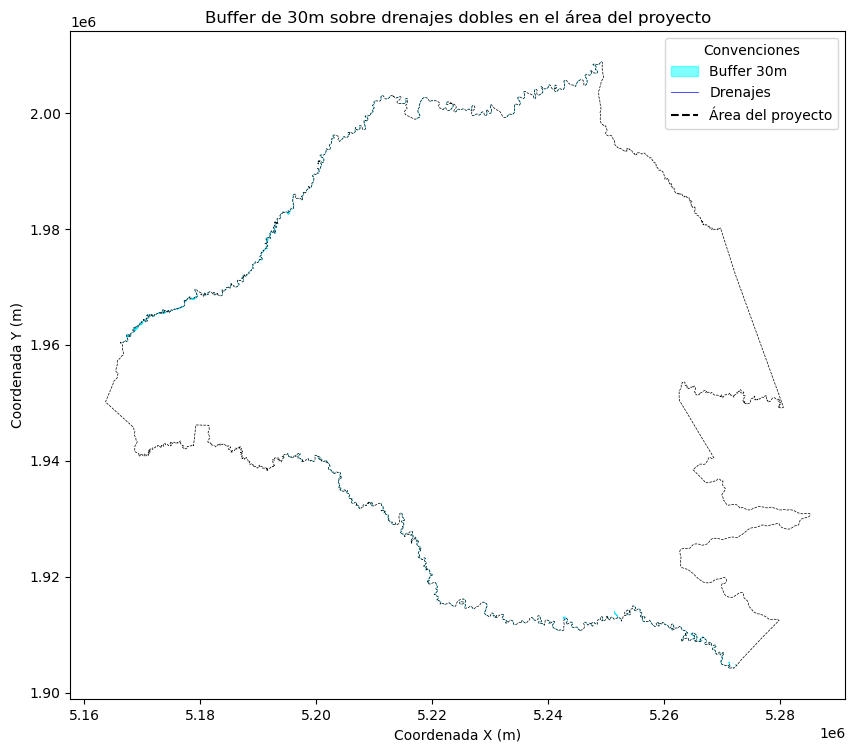

In [51]:
RiversProjectBuffer = RiversProject.copy()

# ---- Crear buffer de 30 metros ----
RiversProjectBuffer["buffer_30m"] = RiversProjectBuffer.geometry.buffer(30)

# Crear un GeoDataFrame con el buffer
buffer_gdf = gpd.GeoDataFrame(RiversProjectBuffer, geometry="buffer_30m", crs=RiversProject.crs)

# ---- Calcular el área de cada polígono de buffer ----
buffer_gdf["area_m2"] = buffer_gdf.geometry.area  # Área en metros cuadrados
buffer_gdf["area_ha"] = buffer_gdf.geometry.area/10000  # Área en hectáreas

#---- Calcular el área total de los buffer
area_total_buffer = buffer_gdf["area_m2"].sum()
area_total_buffer_ha = buffer_gdf["area_ha"].sum()

#---- Caular el área y guardarla en una variable
buffer_area_df = buffer_gdf[["NOMBRE_GEO", "area_m2", "area_ha"]]

# ---- Visualización del Buffer ----
fig, ax = plt.subplots(figsize=(10, 10))

# ---- Imprimir resultados ----
print("📊 Resumen de áreas:")
print(buffer_area_df.describe())
print(f"📊 Área total de las rondas hídricas: {area_total_buffer:.2f} m²")
print(f"📊 Área total de las rondas hídricas en hectáreas: {area_total_buffer_ha:.2f} ha")

# Ploteamos los drenajes originales
RiversProject.plot(ax=ax, color="blue", linewidth=1.5, label="Drenajes")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=0.5, linestyle="dashed", label="Área del proyecto")

# Ploteamos los buffers de 30m
buffer_gdf.plot(ax=ax, color="cyan", alpha=1, label="Buffer 30m")

# ---- Crear leyenda personalizada ----
# Parches de colores para la leyenda
buffer_patch = mpatches.Patch(color="cyan", alpha=0.5, label="Buffer 30m")
drenajes_patch = mlines.Line2D([], [], color="blue", linewidth=0.5, label="Drenajes")
proyecto_patch = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# 📌 **Agregar la leyenda**
ax.legend(handles=[buffer_patch, drenajes_patch, proyecto_patch], title="Convenciones", loc='upper right')

# Configuración del gráfico
ax.set_title("Buffer de 30m sobre drenajes dobles en el área del proyecto")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 3.2.1 Rondas hídricas para el ROI

📊 Resumen de áreas:
            area_m2       area_ha
count  9.600000e+01     96.000000
mean   1.340696e+07   1340.695928
std    4.480464e+07   4480.463756
min    1.807353e+04      1.807353
25%    6.729697e+04      6.729697
50%    2.238523e+05     22.385226
75%    6.045025e+06    604.502450
max    3.666594e+08  36665.942757
📊 Área total de las rondas hídricas: 1287068091.35 m²
📊 Área total de las rondas hídricas en hectáreas: 128706.81 ha


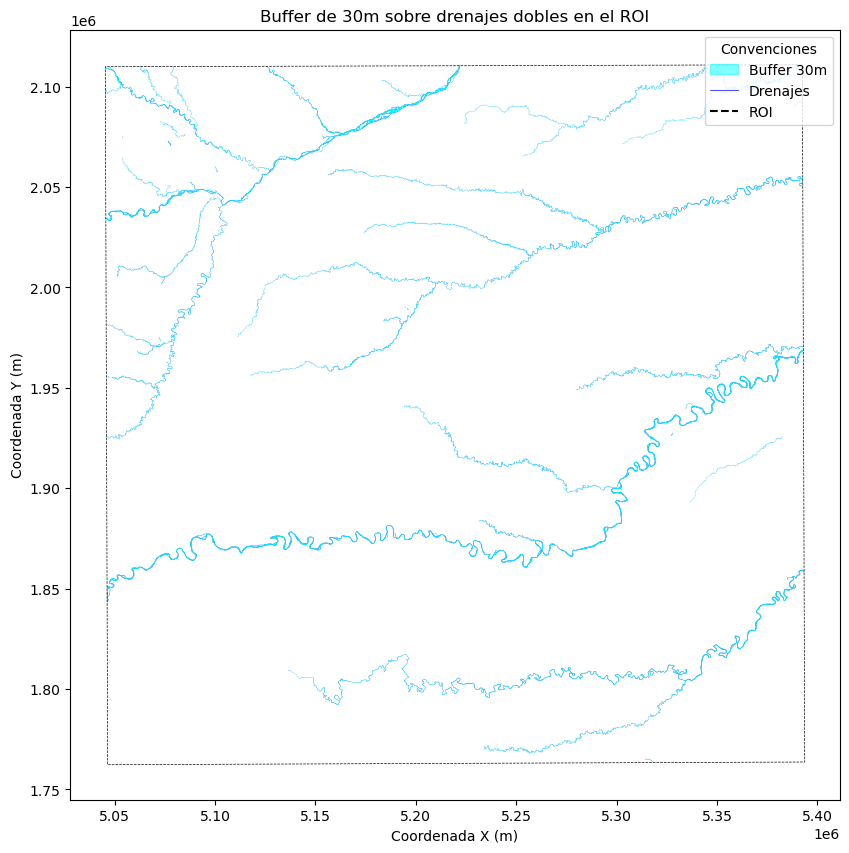

In [52]:
RiversROIBuffer = RiversROI.copy()

# ---- Crear buffer de 30 metros ----
RiversROIBuffer["buffer_30m"] = RiversROIBuffer.geometry.buffer(30)

# Crear un GeoDataFrame con el buffer
buffer_gdf = gpd.GeoDataFrame(RiversROIBuffer, geometry="buffer_30m", crs=RiversROI.crs)

# ---- Calcular el área de cada polígono de buffer ----
buffer_gdf["area_m2"] = buffer_gdf.geometry.area  # Área en metros cuadrados
buffer_gdf["area_ha"] = buffer_gdf.geometry.area/10000  # Área en hectáreas

#---- Calcular el área total de los buffer
area_total_buffer = buffer_gdf["area_m2"].sum()
area_total_buffer_ha = buffer_gdf["area_ha"].sum()

#---- Caular el área y guardarla en una variable
buffer_area_df = buffer_gdf[["NOMBRE_GEO", "area_m2", "area_ha"]]

# ---- Visualización del Buffer ----
fig, ax = plt.subplots(figsize=(10, 10))

# ---- Imprimir resultados ----
print("📊 Resumen de áreas:")
print(buffer_area_df.describe())
print(f"📊 Área total de las rondas hídricas: {area_total_buffer:.2f} m²")
print(f"📊 Área total de las rondas hídricas en hectáreas: {area_total_buffer_ha:.2f} ha")

# Ploteamos los drenajes originales
RiversROI.plot(ax=ax, color="blue", linewidth=1.5, label="Drenajes")
ROI.boundary.plot(ax=ax, color="black", linewidth=0.5, linestyle="dashed", label="ROI")

# Ploteamos los buffers de 30m
buffer_gdf.plot(ax=ax, color="cyan", alpha=1, label="Buffer 30m")

# ---- Crear leyenda personalizada ----
# Parches de colores para la leyenda
buffer_patch = mpatches.Patch(color="cyan", alpha=0.5, label="Buffer 30m")
drenajes_patch = mlines.Line2D([], [], color="blue", linewidth=0.5, label="Drenajes")
proyecto_patch = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Agregar la leyenda**
ax.legend(handles=[buffer_patch, drenajes_patch, proyecto_patch], title="Convenciones", loc='upper right')

# Configuración del gráfico
ax.set_title("Buffer de 30m sobre drenajes dobles en el ROI")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 3.2.4 Clasificación

A continuación se crea una clasificación para determinar la presencia de rondas hídricas.

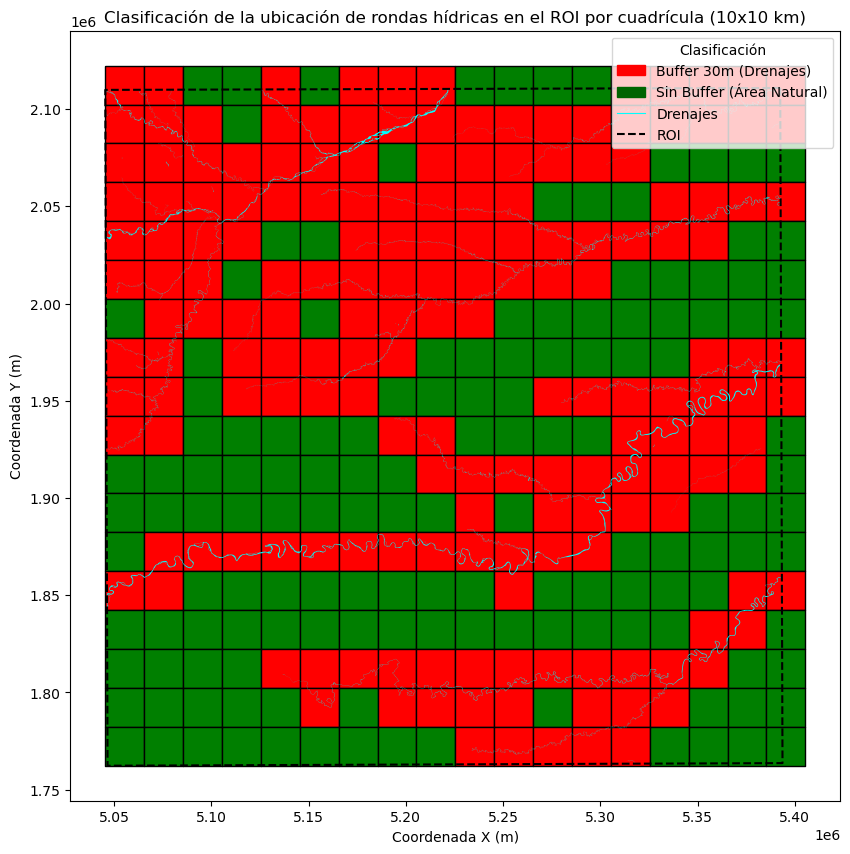

In [53]:
# ---- Crear una cuadrícula sobre el ROI ----
xmin, ymin, xmax, ymax = ROI.total_bounds
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid = gpd.GeoDataFrame({'geometry': polygons}, crs=ROI.crs)

# --------Recortar los bordes para que solo queden celdas dentro del ROI-----------
grid = grid[grid.intersects(ROI.union_all())]

# ---- Clasificación de la cuadrícula ----
# Intersectar la cuadrícula con los buffers
grid["buffer"] = grid.intersects(buffer_gdf.union_all())

# Asignar valores:
# 0 = Buffer (Drenajes)
# 4 = Sin Buffer (Área Natural)
grid["clase"] = np.where(grid["buffer"], 0, 4)

# ---- Visualización ----
fig, ax = plt.subplots(figsize=(10, 10))

# Ploteamos el ROI
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# Ploteamos la cuadrícula clasificada
color_map = {0: "#FF0000", 4: "#007F00"}
grid.plot(ax=ax, color=grid["clase"].map(color_map), edgecolor="black")

# Ploteamos los drenajes originales
RiversROI.plot(ax=ax, color="cyan", linewidth=0.8, label="Drenajes dobles")

# ---- Crear leyenda personalizada ----
buffer_patch = mpatches.Patch(color="red", label="Buffer 30m (Drenajes)")
natural_patch = mpatches.Patch(color="darkgreen", label="Sin Buffer (Área Natural)")
drenajes_patch = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="Drenajes")
ROI_patch = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Agregar la leyenda**
ax.legend(handles=[buffer_patch, natural_patch, drenajes_patch, proyecto_patch], title="Clasificación", loc='upper right')

# Configuración del gráfico
ax.set_title("Clasificación de la ubicación de rondas hídricas en el ROI por cuadrícula (10x10 km)")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

##### 3.2.4 Rasterización

✔️ Raster creado en: Data/rondas_h.tif


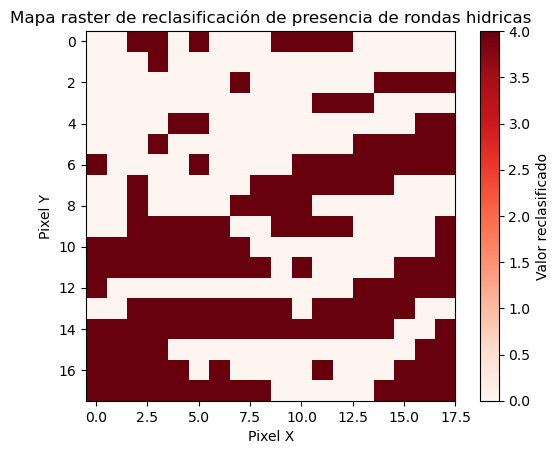

In [55]:
#3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
resraster = 100  # Tamaño de píxel (en unidades del CRS: metros si es proyección UTM)
xmin, ymin, xmax, ymax = grid.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(grid.geometry, grid['clase'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/rondas_h.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa raster de reclasificación de presencia de rondas hidricas")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()

### 4. Áreas naturales protegidas

Dada la naturaleza de las áreas protegidas son zonas donde restrigne el desarorllo de un proyecto de carbono, esto porque la ley ya hace que el territorio tenga una figura de protección hacia los recursos naturales.

Disponible en: https://runap.parquesnacionales.gov.co/cifras

In [56]:
#Insumos 
RunapROI = "Data\\runap.shp"

A continuación se presenta la salida visual de las áreas protegidas contenidas en el ROI

In [57]:
runap=gpd.read_file(RunapROI)

runap.explore()

#### 4.1 Resterizar

Se hace el proceso para rasterizar, donde 0 es aquellas zonas donde no está y 4 donde estan

In [58]:
#) Definir bounding box y resolución con base en el ROI
xmin, ymin, xmax, ymax = ROI.total_bounds
res = res

width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Preparamos las geometrías para rasterizar: valor 0 dentro de runap
shapes = [(geom, 0) for geom in runap.geometry]

# ) Rasterizar
#    - fill=4: las áreas fuera de 'runap' serán 4
#    - dentro de runap, valor 0
raster_arr = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=4,
    transform=transform,
    dtype='uint8'
)

# Metadatos para guardar a disco
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'uint8',
    "crs": ROI.crs,  # Usamos el CRS del ROI (o el que corresponda al shapefile)
    "transform": transform
}

# Guardar el raster final
with rasterio.open("data//RUNAP.tif", "w", **out_meta) as dst:
    dst.write(raster_arr, 1)

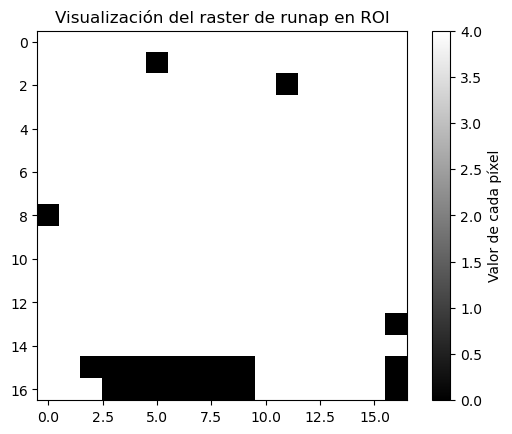

In [59]:
# Abrir el raster con rasterio
with rasterio.open("Data//RUNAP.tif") as src:
    arr = src.read(1)  # Leemos la primera (y única) banda

# Graficar con matplotlib
plt.imshow(arr, cmap='gray')
plt.colorbar(label="Valor de cada píxel")
plt.title("Visualización del raster de runap en ROI")
plt.show()

### 5. Reservas campesinas

En los resguardos campesinos existe una fiura alineada con las actividades REDD+ por ellos es importante tenerla presenta en la regiónd ereferencia

Disponible en: https://data-agenciadetierras.opendata.arcgis.com/datasets/0eca5beb8afe43708622fdd7646cd577_0/explore 

In [60]:
#Insumos 
ResCamp=gpd.read_file("Data\Reserva_Campesina_pr.shp")
ResCamp.explore()

<>:2: SyntaxWarning: invalid escape sequence '\R'
<>:2: SyntaxWarning: invalid escape sequence '\R'
C:\Users\marti\AppData\Local\Temp\ipykernel_32708\2795294600.py:2: SyntaxWarning: invalid escape sequence '\R'
  ResCamp=gpd.read_file("Data\Reserva_Campesina_pr.shp")


#### 5.1 Resterizar

Se hace el proceso para rasterizar, donde 0 es aquellas zonas donde no está y 4 donde estan

In [66]:
#) Definir bounding box y resolución con base en el ROI
xmin, ymin, xmax, ymax = ROI.total_bounds
res = res

width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Preparamos las geometrías para rasterizar: valor 0 dentro de runap
shapes = [(geom, 0) for geom in ResCamp.geometry]

# ) Rasterizar
#    - fill=4: las áreas fuera de 'runap' serán 4
#    - dentro de runap, valor 0
raster_arr = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=4,
    transform=transform,
    dtype='uint8'
)

# Metadatos para guardar a disco
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'uint8',
    "crs": ROI.crs,  # Usamos el CRS del ROI (o el que corresponda al shapefile)
    "transform": transform
}

# Guardar el raster final
with rasterio.open("Data//ResCamp.tif", "w", **out_meta) as dst:
    dst.write(raster_arr, 1)

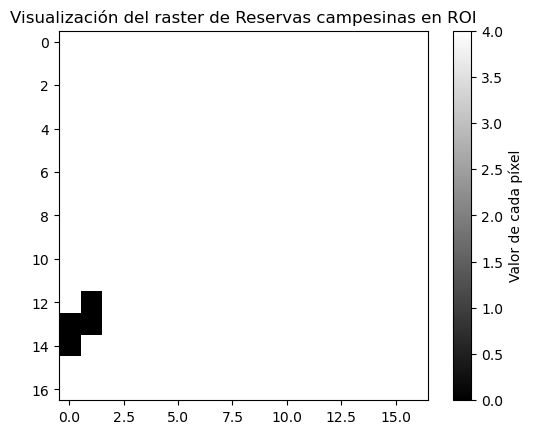

In [67]:
# Abrir el raster con rasterio
with rasterio.open("Data//ResCamp.tif") as src:
    arr = src.read(1)  # Leemos la primera (y única) banda

# Graficar con matplotlib
plt.imshow(arr, cmap='gray')
plt.colorbar(label="Valor de cada píxel")
plt.title("Visualización del raster de Reservas campesinas en ROI")
plt.show()

### 6. Resguardos indigenas formalizados

Al igual que las zonas de reserva campesina, las zonas de resguardo indigena son sitios en donde pueden impactar positivamente las actividades REDD+ 

Disponible en: https://data-agenciadetierras.opendata.arcgis.com/datasets/8944116ccfd34a7189c4bc44b8e19186_0/explore

In [16]:
#Insumos 
ResInd =gpd.read_file("../Data/Resguardo_Indigena_pr.shp")
ResInd.explore()

In [21]:
#) Definir bounding box y resolución con base en el ROI
xmin, ymin, xmax, ymax = ROI.total_bounds
res = res

width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Preparamos las geometrías para rasterizar: valor 0 dentro de runap
shapes = [(geom, 4) for geom in ResInd.geometry]

# ) Rasterizar
#    - fill=4: las áreas fuera de 'runap' serán 4
#    - dentro de runap, valor 0
raster_arr = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='uint8'
)

# Metadatos para guardar a disco
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'uint8',
    "crs": ROI.crs,  # Usamos el CRS del ROI (o el que corresponda al shapefile)
    "transform": transform
}

# Guardar el raster final
with rasterio.open("../data/ResInd.tif", "w", **out_meta) as dst:
    dst.write(raster_arr, 1)

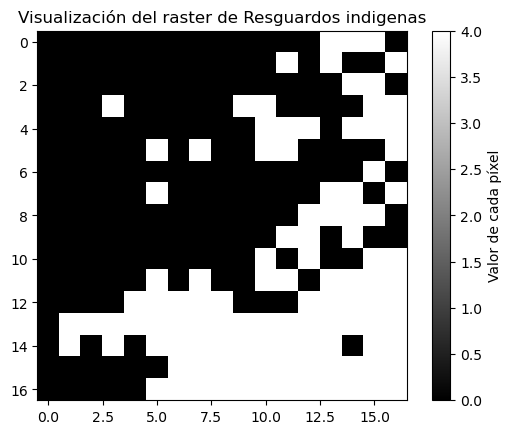

In [22]:
# Abrir el raster con rasterio
with rasterio.open("../Data/ResInd.tif") as src:
    arr = src.read(1)  # Leemos la primera (y única) banda

# Graficar con matplotlib
plt.imshow(arr, cmap='gray')
plt.colorbar(label="Valor de cada píxel")
plt.title("Visualización del raster de Resguardos indigenas")
plt.show()

### 7. Análisis de cambio de coberturas de Bosque y no Bosque

Las caracteristicas de la región permiten que el análisis de coberturas se haga por medio de insumos como el de Global Forest Watch creado por Hansen, a continuación se presentan la deforestación en la zona desde el año 2000

Fuente: https://glad.earthengine.app/view/global-forest-change#bl=off;old=off;dl=5;lon=-79.02946725742085;lat=0.7935388002148703;zoom=6;

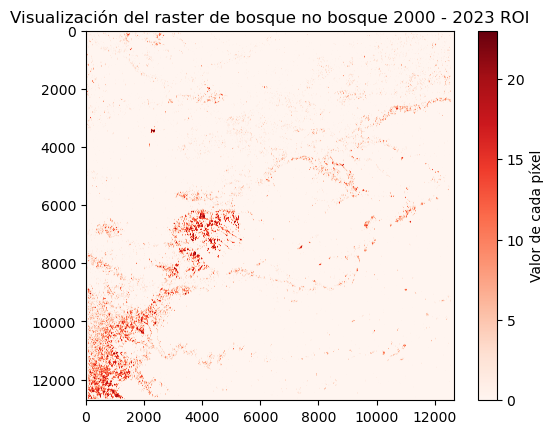

In [71]:
# Abrir el raster con rasterio
with rasterio.open("../Data/Hansen_lossyear_2023.tif") as src:
    arr = src.read(1)  

# Graficar con matplotlib
plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor de cada píxel")
plt.title("Visualización del raster de bosque no bosque 2000 - 2023 ROI")
plt.show()

El insumo anterior solo tiene la pérdida de cobertura de bosque de 2000 a 2023, dada la metodologia del proyecto, se analzian 10 años antes del inicio, es decir de 2013 a 2023, para ello se hace una reclasificación

In [72]:
# Abrir el raster original
with rasterio.open("Data//Hansen_lossyear_2023.tif") as src:
    arr = src.read(1)
    profile = src.profile  # Para copiar metadatos y dimensiones

# Reclasificar
arr_reclas = np.where(arr <= 12, 0, 4)

# Actualizar el perfil si hace falta cambiar el tipo de dato (por ejemplo, a uint8)
profile.update(dtype=rasterio.uint8)

# Guardar el nuevo raster
with rasterio.open("Data//Hansen_lossyear_2023_reclass.tif", "w", **profile) as dst:
    dst.write(arr_reclas.astype(rasterio.uint8), 1)

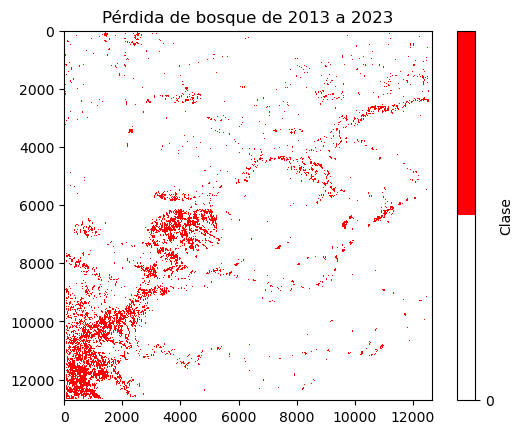

In [73]:
# Creamos un mapa de color para 2 categorías:
#  - La primera categoría (valor 0) la mostramos en un color,
#  - La segunda (valor 1) en otro.
cmap = mcolors.ListedColormap(["white", "red"])

plt.imshow(arr_reclas, cmap=cmap, vmin=0, vmax=1)
plt.colorbar(ticks=[0,4], label="Clase")  # Fijamos la barra a 0 y 1
plt.title("Pérdida de bosque de 2013 a 2023")
plt.show()

Ahora se analiza el origen para hacer un resampleo de Hansem

In [75]:
hansen=gpd.read_file("Data//Hansen_lossyear_2023_reclass.shp")

C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Límites de los Natural Breaks: [  8648.640315    24733.47826399  48028.55450692  80961.9930721
 212410.69681659]


C:\Users\marti\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


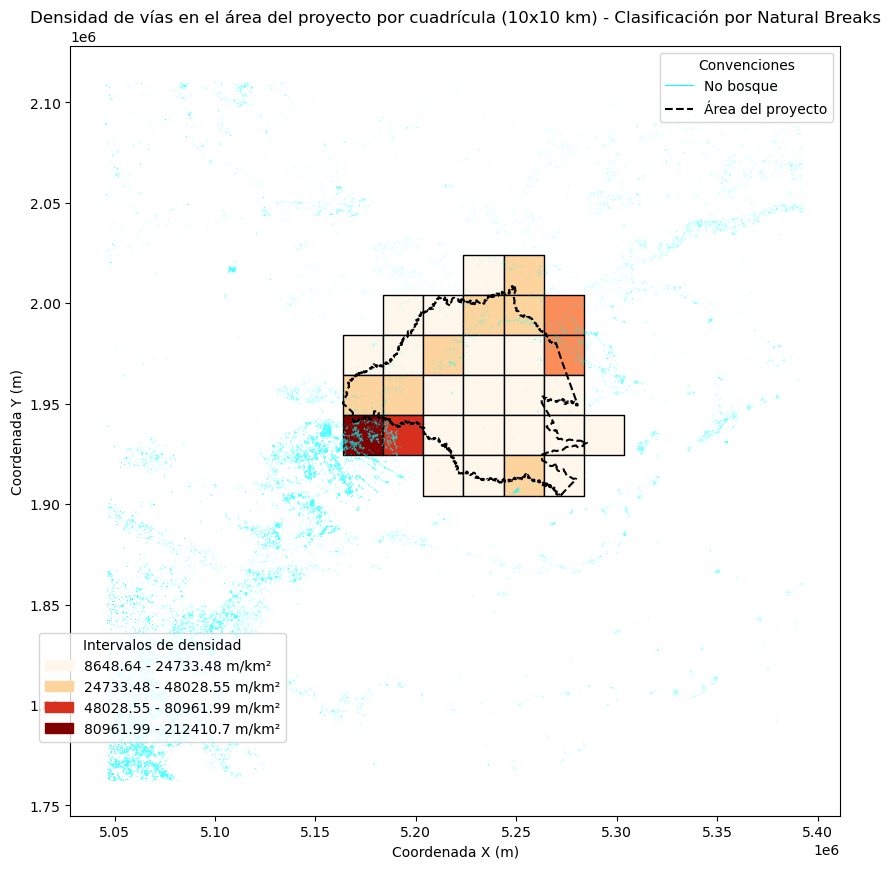

In [76]:
os.environ["OMP_NUM_THREADS"] = "1"

# ---- Definir límites del área del proyecto ----
# Se extraen los límites de la extensión del área del proyecto y el sistema de referencia (CRS)
bounds = ProjectArea.total_bounds
crs = ProjectArea.crs  # Sistema de referencia

# ---- Creación de la cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds

# Se generan las coordenadas de las columnas y filas de la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la Cuadrícula ----
# Se filtran las celdas que intersectan con el área del proyecto
grid = grid[grid.intersects(ProjectArea.union_all())]
grid['id'] = grid.index  # Se asigna un ID único a cada celda

# ---- Recorte de las vías dentro de cada celda ----
# Se intersectan las vías con la cuadrícula para obtener solo las que están dentro de cada celda
hansenClip = gpd.overlay(hansen, grid, how='intersection')

# ---- Cálculo de la longitud de vías por celda ----
# Se calcula la longitud de las vías en metros dentro de cada celda
hansenClip["area_deforestada_m2"] = hansenClip.geometry.area

# Se agrupa la información sumando la longitud total de vías por celda
hansenGrid = hansenClip.groupby("id")["area_deforestada_m2"].sum().reset_index()

# Se unen los datos de longitud de vías a la cuadrícula original
grid = grid.merge(hansenGrid, on="id", how="left").fillna(0)

# ---- Cálculo de la densidad de vías ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid["area_km2"] = (res / 1000) ** 2  # Convertir metros cuadrados a kilómetros cuadrados

# Se calcula la densidad de vías en cada celda (longitud de vías en metros por km²)
grid["densidad_no_bosque"] = grid["area_deforestada_m2"] / grid["area_km2"]

# ---- Clasificación mediante Natural Breaks ----
# Se aplican los Natural Breaks para segmentar los valores de densidad en 5 categorías
nb = mc.NaturalBreaks(grid["densidad_no_bosque"], k=5)
grid["clasificacion"] = nb.yb  # Asignar categorías a cada celda
breaks = nb.bins
print("Límites de los Natural Breaks:", nb.bins)

# ---- Visualización de los resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores para los 5 rangos
cmap = plt.get_cmap("OrRd", 5)  # Obtener la colormap con 5 colores

# Se plotea la cuadrícula con la clasificación por densidad de vías
grid.plot(column="densidad_no_bosque", cmap=cmap, edgecolor="black",
          scheme="NaturalBreaks", legend=True, ax=ax)

# Se plotean las vías y el área del proyecto
hansen.plot(ax=ax, color="cyan", linewidth=0.8, alpha=0.7, label="No bosque")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(breaks[i], 2)} - {round(breaks[i+1], 2)} m/km²" for i in range(len(breaks)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
hansen_legend = mlines.Line2D([], [], color="cyan", linewidth=0.8, label="No bosque")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.15, 0.10, 0.2, 0.2])  # Subimos de y=0.05 a y=0.15
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[hansen_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de vías en el área del proyecto por cuadrícula (10x10 km) - Clasificación por Natural Breaks")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

Media de densidad de no bosque: 20203.3659231789
Desviación estándar de densidad de no bosque: 40410.96531895822
Límites basados en media y desviación estándar: [0, 20203.37, 60614.33, 101025.3, 212410.7]


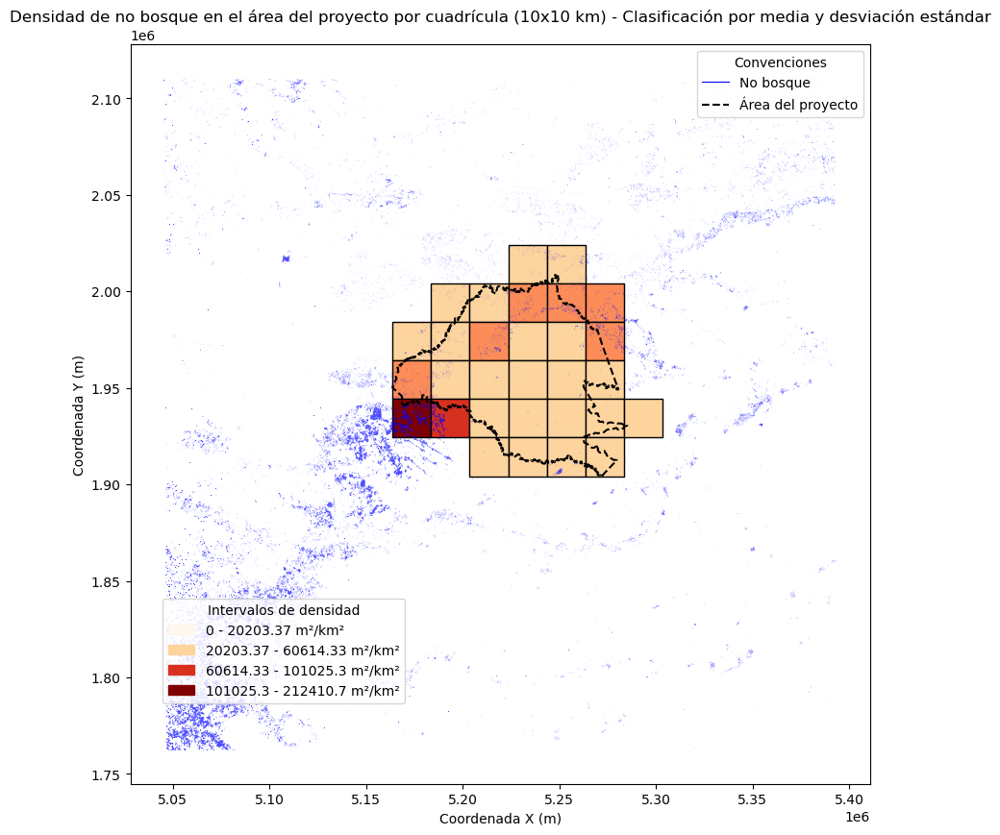

In [77]:
# ---- Cálculo de Media y Desviación Estándar ----
# Se calcula la media (promedio) de la densidad de humedales y su desviación estándar.
mean_density = grid["densidad_no_bosque"].mean()
std_density = grid["densidad_no_bosque"].std()

# Se imprimen los valores calculados
print("Media de densidad de no bosque:", mean_density)
print("Desviación estándar de densidad de no bosque:", std_density)

# ---- Definición de Límites Manuales ----
# Se definen los límites basados en la media y la desviación estándar:
# - Media - 1σ: Un valor por debajo del promedio
# - Media: Punto central de la distribución
# - Media + 1σ, +2σ, +3σ: Valores crecientes que representan desviaciones mayores
bins = [0, 
        mean_density - std_density, 
        mean_density, 
        mean_density + std_density, 
        mean_density + 2 * std_density, 
        grid["densidad_no_bosque"].max()]

# Convertir 'bins' a valores únicos, ordenados y asegurarse de que no haya duplicados
bins = sorted(set([round(b, 2) for b in bins if b >= 0]))

# Asegurar que haya al menos 2 valores distintos en `bins`
if len(bins) < 2:
    raise ValueError("Error: Los límites de clasificación contienen menos de dos valores únicos. Revisa los datos.")

# Se imprimen los límites definidos
print("Límites basados en media y desviación estándar:", bins)

# ---- Visualización de Resultados ----
# Se genera un gráfico que muestra la densidad de humedales usando la clasificación definida por los límites
fig, ax = plt.subplots(figsize=(10, 10))

grid.plot(column="densidad_no_bosque", cmap=cmap, edgecolor="black",
          scheme="UserDefined", classification_kwds={"bins": bins},
          legend=True, ax=ax)

# Se plotean los humedales en color cian
hansen.plot(ax=ax, color="blue", linewidth=0.8, alpha=0.7, label="No bosque")
ProjectArea.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{bins[i]} - {bins[i+1]} m²/km²" for i in range(len(bins)-1)]
colors = plt.get_cmap(cmap, len(labels))(np.linspace(0, 1, len(labels)))  # Obtener colores

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para las vías y el área del proyecto
hansen_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="No bosque")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="Área del proyecto")

# Crear una segunda leyenda en un recuadro aparte
legend2 = fig.add_axes([0.22, 0.11, 0.2, 0.2])  # [x, y, ancho, alto]
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[hansen_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de no bosque en el área del proyecto por cuadrícula (10x10 km) - Clasificación por media y desviación estándar")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

📌 Valor máximo de densidad de humedales: 344962.61 m²/km²


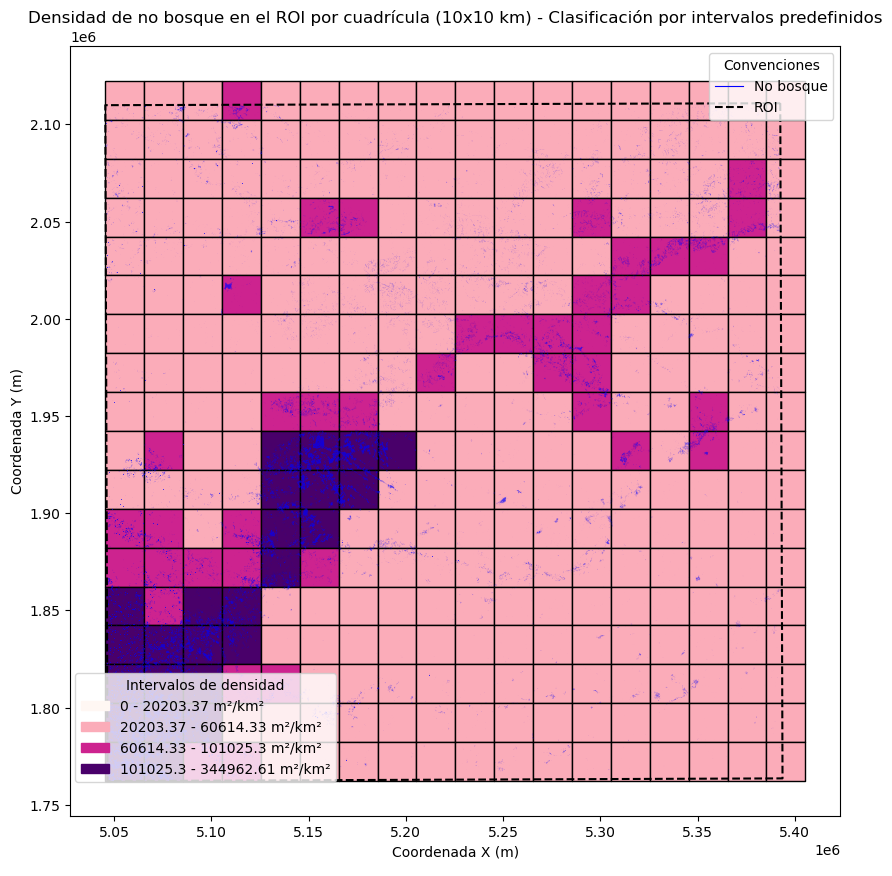

In [78]:
#---- Definir Límites del Área de Interés ----
# Se extraen los límites espaciales y el sistema de referencia (CRS)
bounds_roi = ROI.total_bounds  # [xmin, ymin, xmax, ymax]
crs = ROI.crs  # Sistema de referencia

# ---- Creación de la Cuadrícula ----
# Se define la resolución de la cuadrícula en 10 km (10,000 metros)
xmin, ymin, xmax, ymax = bounds_roi

# Se generan las coordenadas de columnas y filas para la cuadrícula
cols = np.arange(np.floor(xmin), np.ceil(xmax + res), res)
rows = np.arange(np.floor(ymin), np.ceil(ymax + res), res)[::-1]  # Invertir filas para orden cartesiano

# Se crean polígonos cuadrados para cada celda de la cuadrícula
polygons = [
    shapely.Polygon([(x, y), (x + res, y), (x + res, y - res), (x, y - res)])
    for x in cols for y in rows
]

# Se genera un GeoDataFrame con la cuadrícula creada
grid_roi = gpd.GeoDataFrame({'geometry': polygons}, crs=crs)

# ---- Filtrado de la Cuadrícula ----
# Se filtran las celdas que intersectan con el área de interés
grid_roi = grid_roi[grid_roi.intersects(ROI.union_all())]
grid_roi['id'] = grid_roi.index  # Se asigna un ID único a cada celda

# ---- Recorte de los humedales Dentro de Cada Celda ----
# Se intersectan los humedales con la cuadrícula para obtener solo las partes dentro de cada celda
hansenClipROI = gpd.overlay(hansen, grid_roi, how='intersection')

# ---- Cálculo del área de humedales por Celda ----
# Se calcula el área total de humedal dentro de cada celda
hansenClipROI["area_no_bosque_m2"] = hansenClipROI.geometry.area  # Área en metros cuadrados

hansenClipROI = hansenClipROI.groupby("id")["area_no_bosque_m2"].sum().reset_index()

# Se unen los datos de área de humedales a la cuadrícula original
grid_roi = grid_roi.merge(hansenClipROI, on="id", how="left").fillna(0)

# ---- Cálculo de la Densidad de humedales ----
# Se calcula el área de cada celda en km² (10x10 km = 100 km² por celda)
grid_roi["area_km2"] = (res / 1000) ** 2

# Se calcula la densidad de humedales en cada celda
grid_roi["densidad_no_bosque"] = grid_roi["area_no_bosque_m2"] / grid_roi["area_km2"]

# ---- Obtener y Mostrar el Máximo Valor de Densidad de humedales ----
max_density = grid_roi["densidad_no_bosque"].max()
print(f"📌 Valor máximo de densidad de humedales: {max_density:.2f} m²/km²")

# Solución: Ajustar el último bin
upper_limit = max(0, max_density)  # Asegura que el último bin sea mayor al máximo valor

# ---- Definición de Límites de Clasificación ----
# Se establecen los límites de clasificación utilizando Natural Breaks predefinidos
natural_breaks_bins = [0, 20203.3659231789, 60614.3312421371, 101025.296561095, upper_limit]

# ---- Visualización de Resultados ----
fig, ax = plt.subplots(figsize=(10, 10))

# Paleta de colores
cmap = plt.get_cmap("RdPu", len(natural_breaks_bins) - 1)

# Se plotea la cuadrícula con la clasificación definida por densidad de humedales
grid_roi.plot(column="densidad_no_bosque", cmap=cmap, edgecolor="black",
              legend=True, ax=ax, 
              scheme="UserDefined", classification_kwds={"bins": natural_breaks_bins},
              legend_kwds={'fmt': "{:.2f}"})

# Se plotean los humedales en color azul
hansen.plot(ax=ax, color="blue", linewidth=0.8, alpha=0.7, label= "No bosque")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label= "ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para los rangos de densidad
labels = [f"{round(natural_breaks_bins[i], 2)} - {round(natural_breaks_bins[i+1], 2)} m²/km²" 
          for i in range(len(natural_breaks_bins)-1)]
colors = cmap(np.linspace(0, 1, len(labels)))

# Crear parches para la leyenda de densidad
legend_patches = [mpatches.Patch(color=colors[i], label=labels[i]) for i in range(len(labels))]

# Crear elementos de leyenda para vías y área del proyecto
hansen_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="No bosque")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria**
legend2 = fig.add_axes([0.2, 0.06, 0.2, 0.2])  
legend2.legend(handles=legend_patches, title="Intervalos de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área del proyecto
ax.legend(handles=[hansen_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final
ax.set_title("Densidad de no bosque en el ROI por cuadrícula (10x10 km) - Clasificación por intervalos predefinidos")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

In [79]:
# ---- Copia del GeoDataFrame ----
# Se crea una copia del GeoDataFrame de la cuadrícula para trabajar con la clasificación
grid_class = grid_roi.copy()

# ---- Definición de límites y clases ----
# Se establecen los límites de densidad de vías y sus respectivas categorías (de 0 a 4)
bins = [0, 20203.3659231789, 60614.3312421371, 101025.296561095, 344963]
values = [3, 2, 1, 0]

# ---- Asignación de clases ----
# Se clasifica la densidad de vías en la cuadrícula utilizando los límites definidos
grid_class["clase_densidad"] = pd.cut(grid_class["densidad_no_bosque"], bins=bins, labels=values, include_lowest=True)

# Se convierte la columna de clasificación a enteros
grid_class["clase_densidad"] = grid_class["clase_densidad"].astype(int)

# Verificar los valores generados
print("📌 Distribución de la clasificación:")
print(grid_class["clase_densidad"].value_counts().sort_index())

📌 Distribución de la clasificación:
clase_densidad
0     17
1      8
2     40
3    259
Name: count, dtype: int64


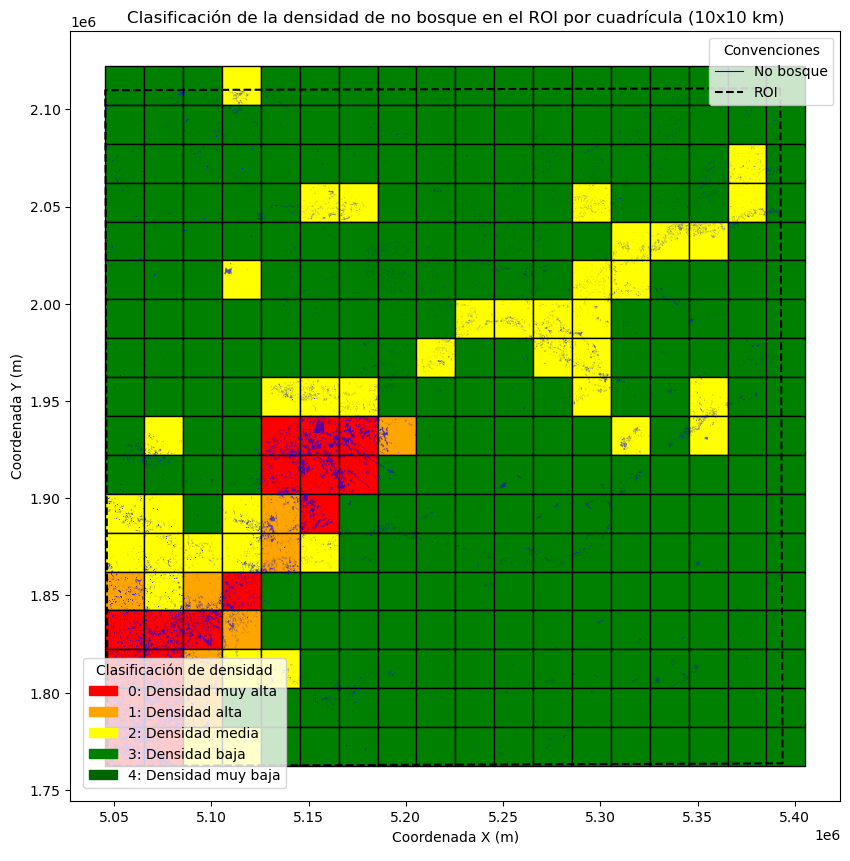

In [80]:
color_map = {
    4: "darkgreen",  # Mayor similitud
    3: "green",
    2: "yellow",
    1: "orange",
    0: "red"  # Menor simulitud
}

# Crear la visualización
fig, ax = plt.subplots(figsize=(10, 10))

# Aplicar la paleta de colores
grid_class.plot(color=grid_class["clase_densidad"].map(color_map), edgecolor="black", ax=ax)

# Ploteo de vías y área de interés (ROI)
hansen.plot(ax=ax, color="blue", linewidth=0.8, alpha=0.7, label="No bosque")
ROI.boundary.plot(ax=ax, color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# ---- Crear leyenda aparte ----

# Definir etiquetas para las clases de densidad
density_labels = {
    4: "4: Densidad muy baja",
    3: "3: Densidad baja",
    2: "2: Densidad media",
    1: "1: Densidad alta",
    0: "0: Densidad muy alta"
}

# Crear parches para la leyenda de clasificación de densidad
legend_patches = [mpatches.Patch(color=color_map[i], label=density_labels[i]) for i in sorted(color_map.keys())]

# Crear elementos de leyenda para vías y área del proyecto
hansen_legend = mlines.Line2D([], [], color="blue", linewidth=0.8, label="No bosque")
area_legend = mlines.Line2D([], [], color="black", linewidth=1.5, linestyle="dashed", label="ROI")

# 📌 **Ajustamos la posición de la leyenda secundaria (subimos un poco)**
legend2 = fig.add_axes([0.15, 0.06, 0.2, 0.2])  # Subimos de y=0.05 a y=0.10
legend2.legend(handles=legend_patches, title="Clasificación de densidad", frameon=True)
legend2.set_xticks([])
legend2.set_yticks([])
legend2.set_frame_on(False)

# Agregar la leyenda principal con vías y área de interés
ax.legend(handles=[hansen_legend, area_legend], title="Convenciones", loc='upper right')

# Configuración final del gráfico
ax.set_title("Clasificación de la densidad de no bosque en el ROI por cuadrícula (10x10 km)")
ax.set_xlabel("Coordenada X (m)")
ax.set_ylabel("Coordenada Y (m)")
plt.show()

✔️ Raster creado en: Data/reclasificado_BNB.tif


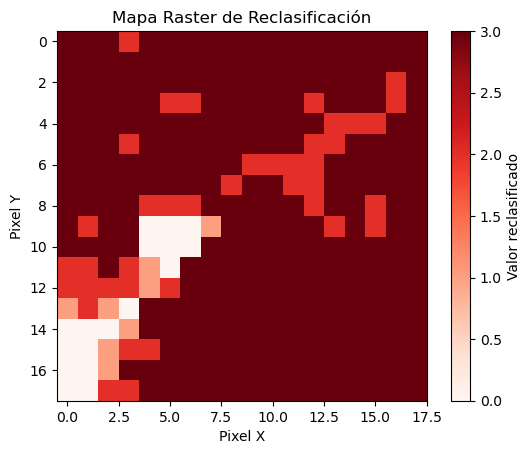

In [81]:
#3) Rasterizar la columna 'Reclasificacion'
# --------------------------------------------------
# Definir resolución y obtener bounding box
resraster = 100  # Tamaño de píxel (en unidades del CRS: metros si es proyección UTM)
xmin, ymin, xmax, ymax = grid_class.total_bounds
width = int((xmax - xmin) / res)
height = int((ymax - ymin) / res)

# Crear la transformación
transform = from_bounds(xmin, ymin, xmax, ymax, width, height)

# Crear la lista de geometrías y valores
shapes = [(geom, val) for geom, val in zip(grid_class.geometry, grid_class['clase_densidad'])]

# Ejecutar rasterización (fuera de polígono = 0, ajusta si prefieres otro valor)
raster_array = rasterize(
    shapes=shapes,
    out_shape=(height, width),
    fill=0,
    transform=transform,
    dtype='int16'
)

# Metadatos para el archivo de salida
raster_out = "Data/reclasificado_BNB.tif"  # Ruta de salida para tu TIFF
out_meta = {
    "driver": "GTiff",
    "height": height,
    "width": width,
    "count": 1,
    "dtype": 'int16',
    "crs": ROI.crs,       # Usar el mismo CRS del shapefile
    "transform": transform
}

# Guardar en disco
with rasterio.open(raster_out, "w", **out_meta) as dst:
    dst.write(raster_array, 1)

print(f"✔️ Raster creado en: {raster_out}")

# --------------------------------------------------
# 4) Visualizar rápidamente el raster resultante
# --------------------------------------------------
with rasterio.open(raster_out) as src:
    arr = src.read(1)

plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor reclasificado")
plt.title("Mapa Raster de Reclasificación")
plt.xlabel("Pixel X")
plt.ylabel("Pixel Y")
plt.show()

### 8. Análisis de elevación y pendiente

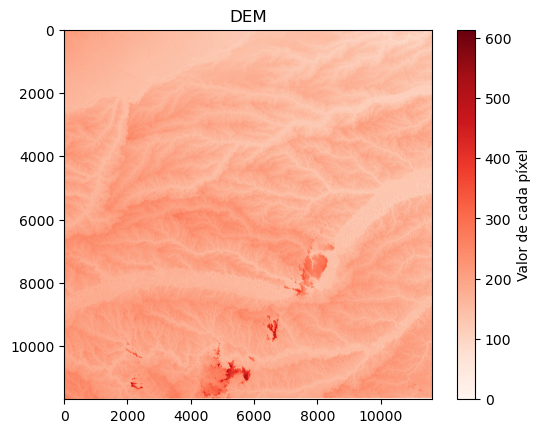

In [82]:
# Abrir el raster con rasterio
with rasterio.open("Data//DEM_ELEVATION_ROI_PROSIG.tif") as src:
    arr = src.read(1)  

# Graficar con matplotlib
plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor de cada píxel")
plt.title("DEM")
plt.show()

In [83]:
#Mapa de pendiente 

import os

In [84]:
os.system('gdaldem slope Data/DEM_ELEVATION_ROI_PROSIG.tif Data/SLOPE.tif')

0

In [85]:
path_in ="Data/DEM_ELEVATION_ROI_PROSIG.tif"
slope_out = "Data/SLOPE.tif"
comando = f'gdaldem slope "{path_in}" "{slope_out}"'
os.system(comando)

0

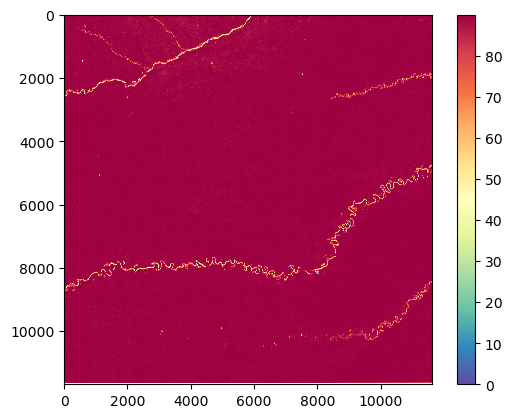

In [86]:
# Pendiente
src_srtm_slope = rasterio.open(slope_out)
srtm_slope = src_srtm_slope.read(1)
srtm_slope[srtm_slope == src_srtm_slope.nodata] = np.nan
fig, ax = plt.subplots()
rasterio.plot.show(src_srtm_slope, cmap='Spectral_r', ax=ax)
fig.colorbar(ax.imshow(srtm_slope, cmap='Spectral_r'), ax=ax);

In [87]:
# Abre el raster y lee la primera banda
with rasterio.open("Data/SLOPE.tif") as src_srtm_slope:
    arr = src_srtm_slope.read(1)

# Calcula el valor mínimo y máximo
min_val = np.min(arr)
max_val = np.max(arr)

print("Valor mínimo:", min_val)
print("Valor máximo:", max_val)

Valor mínimo: -9999.0
Valor máximo: 89.99992


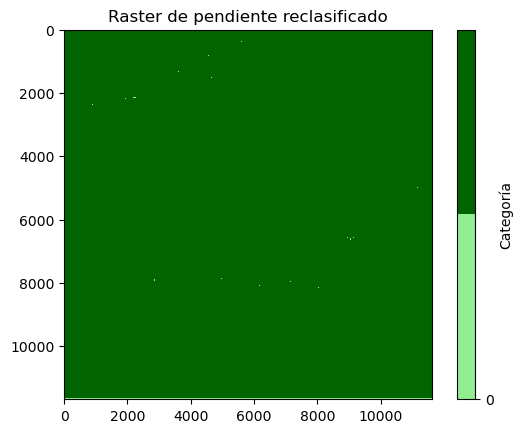

In [88]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Abrir el raster de pendiente
with rasterio.open("Data/SLOPE.tif") as src:
    slope = src.read(1)
    profile = src.profile

# Valor nodata (usualmente -9999)
nodata = -9999.0

# Definir el umbral. En este ejemplo usamos 45 grados
threshold = 45.0

# Reclasificar: 
# - Si el valor es nodata se mantiene
# - Si la pendiente es menor a 45 se asigna 0
# - Si es mayor o igual se asigna 1
slope_reclass = np.where(slope == nodata, nodata, np.where(slope < threshold, 0, 4))

# Visualizar el raster reclasificado con dos colores definidos
cmap = mcolors.ListedColormap(["lightgreen", "darkgreen"])
plt.imshow(slope_reclass, cmap=cmap, vmin=0, vmax=1)
plt.colorbar(ticks=[0, 4], label="Categoría")
plt.title("Raster de pendiente reclasificado")
plt.show()


### 9. Suma de rasters y resultado final

Con los antertiores insumos ya rasterizados bajo la misma resulución se procede a llamar a cada uno para agruparlos, de forma inicial se debe analziar si tienen la misma dimensión, dado a que si bien estyán bajo el mismo roi por la naturaleza de cada uno pueden tener dimensiones diferentes.

In [90]:
# Lista de rásteres
raster_files = [
    "Data/landCover.tif",
    "Data/vias.tif",
    "Data/Drenajes_dobles.tif",
    "Data/asentamientos.tif",
    "Data/humedales.tif",
    "Data/rondas_h.tif",
    "Data/RUNAP.tif",
    "Data/ResCamp.tif",
    "Data/ResInd.tif",
    "Data/reclasificado_BNB.tif"
]

# Diccionario para almacenar datos y perfiles
rasters_data = {}
profiles = {}

# Leer los rásteres y obtener la dimensión mínima
min_rows, min_cols = float("inf"), float("inf")

for raster in raster_files:
    with rasterio.open(raster) as src:
        data = src.read(1)  # Leer la banda 1
        rasters_data[raster] = data
        profiles[raster] = src.profile
        
        # Obtener la menor dimensión encontrada
        min_rows = min(min_rows, data.shape[0])
        min_cols = min(min_cols, data.shape[1])
        
        print(f"Forma del raster {raster}: {data.shape}")

print(f"\nDimensión mínima a la que se ajustarán los rásteres: ({min_rows}, {min_cols})\n")

# Recortar todos los rásteres a la dimensión mínima y guardarlos
for raster, data in rasters_data.items():
    # Recortar a la dimensión mínima
    data_cropped = data[:min_rows, :min_cols]

    # Actualizar el perfil con el nuevo tamaño
    profile = profiles[raster]
    profile.update(width=min_cols, height=min_rows)

    # Guardar el nuevo raster ajustado
    output_raster = raster.replace(".tif", "_ajustado.tif")
    with rasterio.open(output_raster, "w", **profile) as dst:
        dst.write(data_cropped, 1)

    print(f"Guardado raster ajustado: {output_raster}")

print("\n✅ Todos los rásteres han sido ajustados correctamente.")

Forma del raster Data/landCover.tif: (17, 17)
Forma del raster Data/vias.tif: (18, 18)
Forma del raster Data/Drenajes_dobles.tif: (18, 18)
Forma del raster Data/asentamientos.tif: (17, 17)
Forma del raster Data/humedales.tif: (18, 18)
Forma del raster Data/rondas_h.tif: (18, 18)
Forma del raster Data/RUNAP.tif: (17, 17)
Forma del raster Data/ResCamp.tif: (17, 17)
Forma del raster Data/ResInd.tif: (17, 17)
Forma del raster Data/reclasificado_BNB.tif: (18, 18)

Dimensión mínima a la que se ajustarán los rásteres: (17, 17)

Guardado raster ajustado: Data/landCover_ajustado.tif
Guardado raster ajustado: Data/vias_ajustado.tif
Guardado raster ajustado: Data/Drenajes_dobles_ajustado.tif
Guardado raster ajustado: Data/asentamientos_ajustado.tif
Guardado raster ajustado: Data/humedales_ajustado.tif
Guardado raster ajustado: Data/rondas_h_ajustado.tif
Guardado raster ajustado: Data/RUNAP_ajustado.tif
Guardado raster ajustado: Data/ResCamp_ajustado.tif
Guardado raster ajustado: Data/ResInd_ajust

Posterior a esto ya se peude hacer el proceso de sumarlos ya que se aseguro que estuvieran bajo la misma estrcutura. 

In [93]:
raster_files = [
    "Data/landCover_ajustado.tif",
    "Data/vias_ajustado.tif",
    "Data/Drenajes_dobles_ajustado.tif",
    "Data/asentamientos_ajustado.tif",
    "Data/humedales_ajustado.tif",
    "Data/rondas_h_ajustado.tif",
    "Data/RUNAP_ajustado.tif",
    "Data/ResCamp_ajustado.tif",
    "Data/ResInd_ajustado.tif",
    "Data/reclasificado_BNB_ajustado.tif"
]
# Abrir el primer raster para obtener los metadatos
with rasterio.open(raster_files[0]) as src:
    meta = src.meta.copy()
    data_sum = np.zeros((src.height, src.width), dtype=np.float32)  # Asegurar float32
    count_valid = np.zeros((src.height, src.width), dtype=np.int32)  # Contador de valores válidos

# Leer, filtrar y sumar los rásteres
for raster in raster_files:
    with rasterio.open(raster) as src:
        data = src.read(1).astype(np.float32)  # Convertir a float32
        data[data == 15] = np.nan  # Reemplazar 15 por NaN
        valid_mask = ~np.isnan(data)  # Máscara de valores válidos
        data_sum[valid_mask] += data[valid_mask]  # Sumar solo valores válidos
        count_valid[valid_mask] += 1  # Contar cuántos valores válidos contribuyen a cada píxel

# Evitar valores NaN en el resultado final
data_sum[count_valid == 0] = np.nan  # Si no hubo datos válidos en un píxel, dejar como NaN

# Guardar el resultado
output_file = "Data/Output/Suma_Rasters_Sin15.tif"
meta.update(dtype=rasterio.float32, nodata=np.nan)  # Definir nodata como NaN

with rasterio.open(output_file, "w", **meta) as dst:
    dst.write(data_sum, 1)

print(f"Archivo guardado en: {output_file}")

Archivo guardado en: Data/Output/Suma_Rasters_Sin15.tif


COn lo anterior se procede a hacer la suma de estos rasters

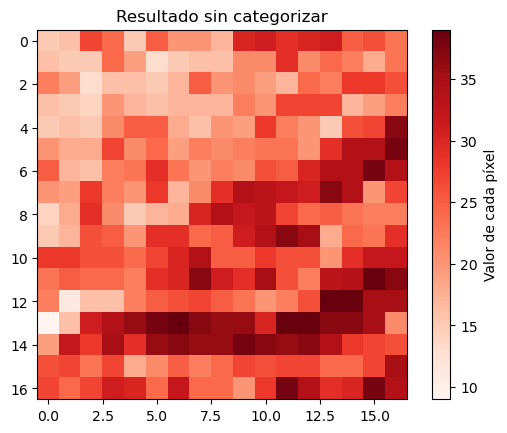

Imagen del histograma guardada en: Results/Resultado_sin_Categorizar.png


In [127]:
# Abrir el raster con rasterio
output_image_path = "Results/Resultado_sin_Categorizar.png"  # Ruta donde se guardará la imagen

with rasterio.open("Data/Output/Suma_Rasters_Sin15.tif") as src:
    arr = src.read(1)  

# Graficar con matplotlib
plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor de cada píxel")
plt.title("Resultado sin categorizar")
# Guardar la imagen
plt.savefig(output_image_path, dpi=300, bbox_inches='tight')  

# Mostrar la imagen en pantalla
plt.show()

print(f"Imagen del histograma guardada en: {output_image_path}")

#### 9.1. Estadisticas de resultados

Se obtienen estadisticas con la finalidad de poder establecer intervalos y hacer una reclasificación para poder distinguir mejor la región de refrencia

In [112]:
# Definir la ruta del raster
raster_path = "Data/Output/Suma_Rasters_Sin15.tif"

# Abrir el raster
with rasterio.open(raster_path) as src:
    data = src.read(1)  # Leer la banda 1
    data = data[data != src.nodata]  # Eliminar valores NoData

# Calcular estadísticas
stats = {
    "Min": np.min(data),
    "Max": np.max(data),
    "Mean": np.mean(data),
    "Median": np.median(data),
    "Std": np.std(data),
    "Sum": np.sum(data),
    "Pixel Count": data.size
}

import pandas as pd

df_stats = pd.DataFrame(stats, index=["Valor"])
print(df_stats)

       Min   Max       Mean  Median       Std     Sum  Pixel Count
Valor  9.0  39.0  25.411764    25.0  6.829105  7344.0          289


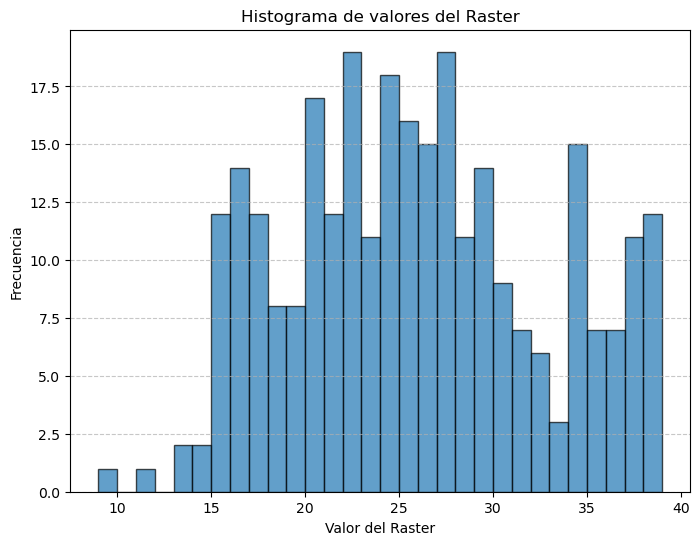

Imagen del histograma guardada en: Results/Histograma_Raster.png


In [124]:
# Ruta del raster
raster_path = "Data/Output/Suma_Rasters_Sin15.tif"
output_image_path = "Results/Histograma_Raster.png"  # Ruta donde se guardará la imagen

# Abrir el raster y leer la banda 1
with rasterio.open(raster_path) as src:
    data = src.read(1)  # Leer la banda 1
    nodata = src.nodata  # Obtener el valor NoData

# Filtrar valores NoData
if nodata is not None:
    data = data[data != nodata]

# Crear el histograma
plt.figure(figsize=(8, 6))
plt.hist(data.ravel(), bins=30, edgecolor="black", alpha=0.7)
plt.xlabel("Valor del Raster")
plt.ylabel("Frecuencia")
plt.title("Histograma de valores del Raster")
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Guardar la imagen
plt.savefig(output_image_path, dpi=300, bbox_inches='tight')  

# Mostrar la imagen en pantalla
plt.show()

print(f"Imagen del histograma guardada en: {output_image_path}")


Con la información obtenida del histograma se establecen los intervalos para reclasificar

In [115]:
# Abrir el raster original
input_raster = "Data/Output/Suma_Rasters_Sin15.tif"
output_raster = "Data/Output/Suma_Rasters_Reclasificado.tif"

# Definir la función de reclasificación
def reclassify(array):
    classified = np.zeros_like(array, dtype=np.uint8)
    classified[(array >= 9) & (array <= 14)] = 0
    classified[(array >= 15) & (array <= 19)] = 1
    classified[(array >= 20) & (array <= 24)] = 2
    classified[(array >= 25) & (array <= 29)] = 3
    classified[(array >= 30) & (array <= 39)] = 4
    return classified

# Leer el raster
with rasterio.open(input_raster) as src:
    raster_data = src.read(1)  # Leer la banda 1
    profile = src.profile  # Copiar metadatos

# Aplicar reclasificación
reclassified_data = reclassify(raster_data)

# Guardar el raster reclasificado
profile.update(dtype=rasterio.uint8, nodata=255)

with rasterio.open(output_raster, "w", **profile) as dst:
    dst.write(reclassified_data, 1)

print("Reclasificación completada. Archivo guardado en:", output_raster)

Reclasificación completada. Archivo guardado en: Data/Output/Suma_Rasters_Reclasificado.tif


Ya con esto ajustado se presenta el resultado final categorizado

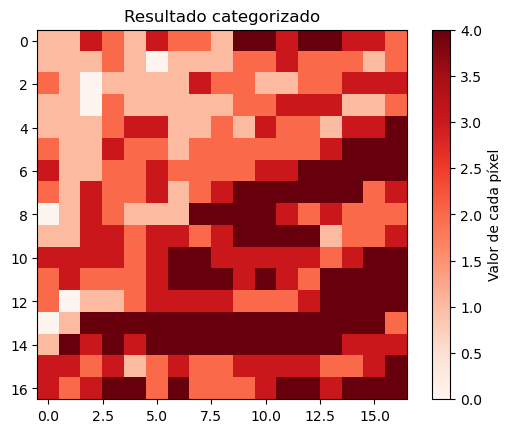

Imagen del histograma guardada en: Results/Resultado_Categorizado.png


In [125]:
# Abrir el raster con rasterio
output_image_path = "Results/Resultado_Categorizado.png"  # Ruta donde se guardará la imagen
with rasterio.open("Data/Output/Suma_Rasters_Reclasificado.tif") as src:
    arr = src.read(1)  

# Graficar con matplotlib
plt.imshow(arr, cmap='Reds')
plt.colorbar(label="Valor de cada píxel")
plt.title("Resultado categorizado")
# Guardar la imagen
plt.savefig(output_image_path, dpi=300, bbox_inches='tight')  

# Mostrar la imagen en pantalla
plt.show()

print(f"Imagen del histograma guardada en: {output_image_path}")


Se hace un análisis final para ver aquellas variables de las categorias con mayores valores y poder resaltar mejor la región de refrencia.

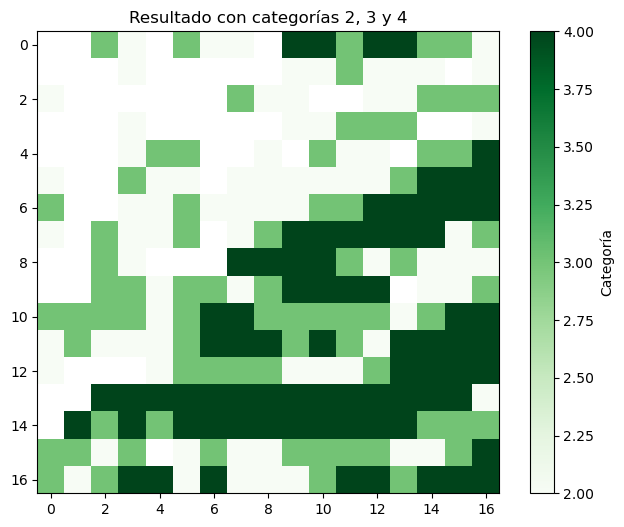

Imagen del histograma guardada en: Results/Resultado_Categoria_234.png


In [126]:
# Ruta del raster (ajusta la ruta si es necesario)
output_image_path = "Results/Resultado_Categoria_234.png"  
raster_path = "Data/Output/Suma_Rasters_Reclasificado.tif"

# Abrir el raster y leer los datos
with rasterio.open(raster_path) as src:
    arr = src.read(1)  # Leer la banda 1

# Crear una máscara para mostrar solo las categorías 3 y 4
filtered_arr = np.where((arr == 3) | (arr == 4) | (arr == 2), arr, np.nan)

# Graficar el raster filtrado
plt.figure(figsize=(8, 6))
plt.imshow(filtered_arr, cmap='Greens', interpolation='none')
plt.colorbar(label="Categoría")
plt.title("Resultado con categorías 2, 3 y 4")
# Guardar la imagen
plt.savefig(output_image_path, dpi=300, bbox_inches='tight')  

# Mostrar la imagen en pantalla
plt.show()

print(f"Imagen del histograma guardada en: {output_image_path}")